<a href="https://colab.research.google.com/github/ArnaudDavyMM/Computer-Vision--AI/blob/main/rsna_2023_abdominal_trauma_detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Overview :

    Traumatic injury is the most common cause of death in the first four decades of life and a major public health problem around the world. There are estimated to be more than 5 million annual deaths worldwide from traumatic injury. Prompt and accurate diagnosis of traumatic injuries is crucial for initiating appropriate and timely interventions, which can significantly improve patient outcomes and survival rates. Computed tomography (CT) has become an indispensable tool in evaluating patients with suspected abdominal injuries due to its ability to provide detailed cross-sectional images of the abdomen.

    Abdominal trauma is among the most common types of traumatic injury, with the most frequent cause being motor vehicle accidents. Abdominal trauma may result in damage and internal bleeding of the internal organs, including the liver, spleen, kidneys, and bowel. Detection and classification of injuries are key to effective treatment and favorable outcomes. A large proportion of patients with abdominal trauma require urgent surgery. Abdominal trauma often cannot be diagnosed clinically by physical exam, patient symptoms, or laboratory tests.

    Prompt diagnosis of abdominal trauma using medical imaging is thus critical to patient care. AI tools that assist and expedite diagnosis of abdominal trauma have the potential to substantially improve patient care and health outcomes in the emergency setting.

## Why this project ?

    Well, Biodmedical imaging or Computed Tomography scans (CT Images) analysis are relevant and presente many specific challengies to work with I was not aware of. Below are the main challenges I faced:

    1. Specific medical image format : Biomedical imaging uses DICOM and NIFTI format. The main difference between these two formats is that the DICOM format has multiple 2D image slices which together form a 3D image, whereas the NIfTI format has only one file that contains the 3D image.


    2. Data annotation: Medical image data often requires expert annotation, which can be time-consuming and expensive. Additionally, there can be variations in annotation quality and consistency, which can affect the performance of the segmentation model.

    3. Data Ambiguity and complexity: Medical images can be complex and heterogeneous, with variations in image quality, resolution, and modality (Image variability). This can make it difficult to develop accurate, robust DL models and technics such as segmentation models to jsut name that.

    4. Model interpretability: Medical image segmentation models can be difficult to interpret, which can make it challenging to understand how the model is making its predictions.

    5. Training instability: Deep learning models can be sensitive to the choice of hyperparameters and the quality of the training data, which can lead to training instability and poor performance.

    6. Computational complexity: Large datasets and high-dimensional images require substantial computational resources and time.
    
    7. Data access: Medical image data is often subject to strict privacy regulations, which can make it difficult to access and use for research purposes.

    To overcome these challenges, it is important to carefully use appropriate preprocessing techniques, and carefully annotate the data, design and evaluate the segmentation model. Additionally, it is was necessary to use specialized tools and frameworks, such as DLTK, to enable image preprocessing, data visualization, deep learning on biomedical images and improve the performance of the model.


## Goal of the Project :

    First and foremost, this project aims to perform modern Biomedical imaging Analysis or Computed Tomography scans Analys.
    Thus, the second part will be focused on Machine Learning including Deep Learning and AI to identify several potential injuries in CT scans of trauma patients and help medical personnel detect injuries and grade their severity more quickly and precisely.
    Advanced algorithms for this purpose have the potential to enhance trauma care and patient outcomes globally. Any of these injuries can be fatal on a short time frame if untreated so there is great value in rapid diagnosis.

    It is worth saying that interpreting CT scans for abdominal trauma, however, can be a complex and time-consuming task, especially when multiple injuries or areas of subtle active bleeding are present. This challenge seeks to harness the power of artificial intelligence and machine learning to assist medical professionals in rapidly and precisely detecting injuries and grading their severity. The development of advanced algorithms for this purpose has the potential to improve trauma care and patient outcomes worldwide


## Approach :

    1. Data preprocessing

    2. EDA including data visualization prior to correct for noise under or over exposure.

    3. Data engineering, future extraction, splitting data & data augmentation.
        The following is the split ratio used for this project
        Training set (80%)
        Validation set (10%)
        Testing set (10%)
    
    4. Model
        Definie the distributed training strategy.
        Definie the number of shared instances.
        Define a Deep Learning architecture to extract features from the model.
        Define parameters like the loss, optimizer, epochs, learning rate, and evaluation metric.
        Define checkpoints.
        run the model until an accuracy of at least 70% is obtained.
    
    5. Evaluate (choose the best model & evalaution metrics from the evalidation set).
    
    6. Use test set for final evaluation then save the model.
    
    6. Interprete the result.

In [ ]:
# !pip install pydicom

In [ ]:
# !pip install python-gdcm

In [ ]:
# !pip install pylibjpeg pylibjpeg-libjpeg pydicom

In [ ]:
# !pip install nibabel

In [ ]:
# !pip install imageio

## Import Librairies & Dependencis

In [ ]:
import sys
import warnings

if not sys.warnoptions:
    import warnings
    warnings.simplefilter("ignore")

warnings.filterwarnings("ignore", category=DeprecationWarning)
warnings.filterwarnings("ignore", category=UserWarning)


In [ ]:
# DATA MANIPULATION
import numpy as np
import pandas as pd
import pandas.api.types
from scipy import stats
import scipy.ndimage as ndi

# DATA VISUALIZATION - PLOTS
from matplotlib.animation import FuncAnimation
import matplotlib.pyplot as plt
import seaborn as sbn
%matplotlib inline


# IMAGE PREPROCESSING & VISUALIZATION
import time
import cv2
import os, shutil

import gdcm
import imageio as iio
import nibabel as nib
import pydicom as dicom
import SimpleITK as sitk
import albumentations as A
import ipywidgets as widgets

from PIL import *
from skimage import *
from pydicom import *
from glob import glob
from tqdm import tqdm
from pathlib import Path
from pydicom.data import *
from skimage.filters import *
from subprocess import check_output

In [ ]:
# DEEP LEARNING LIBRAIRIES & DEPENDENCIES
import tensorflow as tf
import keras_cv
import keras_utils
import keras_core as keras

from keras import *
from keras_core import *
from keras.layers import *
from sklearn.utils import *
from keras.callbacks import *
from keras import backend as K
from keras.preprocessing import *
from sklearn.model_selection import *
from keras.preprocessing.image import *

# EVALUATION METRICS
from sklearn.model_selection import *
from sklearn.metrics import *

2023-09-28 23:07:10.235087: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-09-28 23:07:11.162955: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


Using TensorFlow backend


## 1. DATA PROPROCESSING

In [ ]:
# Set dataset root
dsroot ='/home/mukwa/Desktop/rsna-2023-abdominal-trauma-detection'

In [ ]:
!ls {dsroot}

image_level_labels.csv	 test_images		   train_images
sample_submission.csv	 test_series_meta.csv	   train_series_meta.csv
segmentations		 train.csv
test_dicom_tags.parquet  train_dicom_tags.parquet


In [ ]:
for i in os.listdir(dsroot):
    if os.path.isdir(os.path.join(dsroot, i)):
        print(f'{i} - Directory')
    else:
        print(f'{i} - File')

train_series_meta.csv - File
sample_submission.csv - File
train.csv - File
train_images - Directory
train_dicom_tags.parquet - File
test_series_meta.csv - File
image_level_labels.csv - File
test_images - Directory
segmentations - Directory
test_dicom_tags.parquet - File


#### As per the result obtained above our main directory contains the following files :

    1. image_level_labels.csv - File in csv format*
    2. sample_submission.csv - File in csv format
    3. test_series_meta.csv - File in csv format
    4. train_series_meta.csv - File in csv format
    5. test_dicom_tags.parquet - File in parquet format
    6. train_dicom_tags.parquet - file parquet format
    
    Directory or Folders
        1. train_images
        2. test_images
        3. segmentations

## 2. EDA

#### As per the result, we can conclude that we have six (6) and three directories

In [ ]:
train_images = os.listdir(os.path.join(dsroot, 'train_images'))
print('Below is train_images :')
print(f'--> {train_images[0]}')
for dir in os.listdir(os.path.join(dsroot, f'train_images/{train_images[0]}')):
    print(f' --> {dir}')
    for img in os.listdir(os.path.join(dsroot, f'train_images/{train_images[0]}/{dir}'))[:15]:
        print(f' --> {img}')
print(' ... ')

Below is train_images :
--> 64263
 --> 40690
 --> 18.dcm
 --> 14.dcm
 --> 52.dcm
 --> 74.dcm
 --> 143.dcm
 --> 121.dcm
 --> 123.dcm
 --> 8.dcm
 --> 30.dcm
 --> 149.dcm
 --> 49.dcm
 --> 145.dcm
 --> 13.dcm
 --> 138.dcm
 --> 156.dcm
 --> 47672
 --> 189.dcm
 --> 200.dcm
 --> 52.dcm
 --> 74.dcm
 --> 143.dcm
 --> 121.dcm
 --> 123.dcm
 --> 195.dcm
 --> 149.dcm
 --> 174.dcm
 --> 145.dcm
 --> 138.dcm
 --> 156.dcm
 --> 219.dcm
 --> 122.dcm
 ... 


**As per our result, we can conclude the medical imaging or the CT (Computed tomography) scan data, in DICOM format of all patients stored into folders which may contain one or two differents sub-folders named by patient id becaus each patient may have been scanned once or twice. Each scan contains a series of images. In addition, it worth noting that all medical imaging does not have the same bit per pixel, pixel range, and pixel representation**.

**LOAD & VIEW LABELS (In CSV format)**

In [ ]:
train_labels = pd.read_csv(os.path.join(dsroot, 'train.csv'))
train_labels.shape

(3147, 15)

In [ ]:
print('Training data Rows : %s Columns : %s ' % (str(train_labels.shape[0]),str(train_labels.shape[1])))

Training data Rows : 3147 Columns : 15 


In [ ]:
train_labels.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3147 entries, 0 to 3146
Data columns (total 15 columns):
 #   Column                 Non-Null Count  Dtype
---  ------                 --------------  -----
 0   patient_id             3147 non-null   int64
 1   bowel_healthy          3147 non-null   int64
 2   bowel_injury           3147 non-null   int64
 3   extravasation_healthy  3147 non-null   int64
 4   extravasation_injury   3147 non-null   int64
 5   kidney_healthy         3147 non-null   int64
 6   kidney_low             3147 non-null   int64
 7   kidney_high            3147 non-null   int64
 8   liver_healthy          3147 non-null   int64
 9   liver_low              3147 non-null   int64
 10  liver_high             3147 non-null   int64
 11  spleen_healthy         3147 non-null   int64
 12  spleen_low             3147 non-null   int64
 13  spleen_high            3147 non-null   int64
 14  any_injury             3147 non-null   int64
dtypes: int64(15)
memory usage: 368.9 KB


In [ ]:
train_labels.head()

,patient_id,bowel_healthy,bowel_injury,extravasation_healthy,extravasation_injury,kidney_healthy,kidney_low,kidney_high,liver_healthy,liver_low,liver_high,spleen_healthy,spleen_low,spleen_high,any_injury
0,10004,1,0,0,1,0,1,0,1,0,0,0,0,1,1
1,10005,1,0,1,0,1,0,0,1,0,0,1,0,0,0
2,10007,1,0,1,0,1,0,0,1,0,0,1,0,0,0
3,10026,1,0,1,0,1,0,0,1,0,0,1,0,0,0
4,10051,1,0,1,0,1,0,0,1,0,0,0,1,0,1


In [ ]:
# Show all duplicates in dataframe
train_labels.duplicated().sum()

0

In [ ]:
train_labels.nunique()

patient_id               3147
bowel_healthy               2
bowel_injury                2
extravasation_healthy       2
extravasation_injury        2
kidney_healthy              2
kidney_low                  2
kidney_high                 2
liver_healthy               2
liver_low                   2
liver_high                  2
spleen_healthy              2
spleen_low                  2
spleen_high                 2
any_injury                  2
dtype: int64

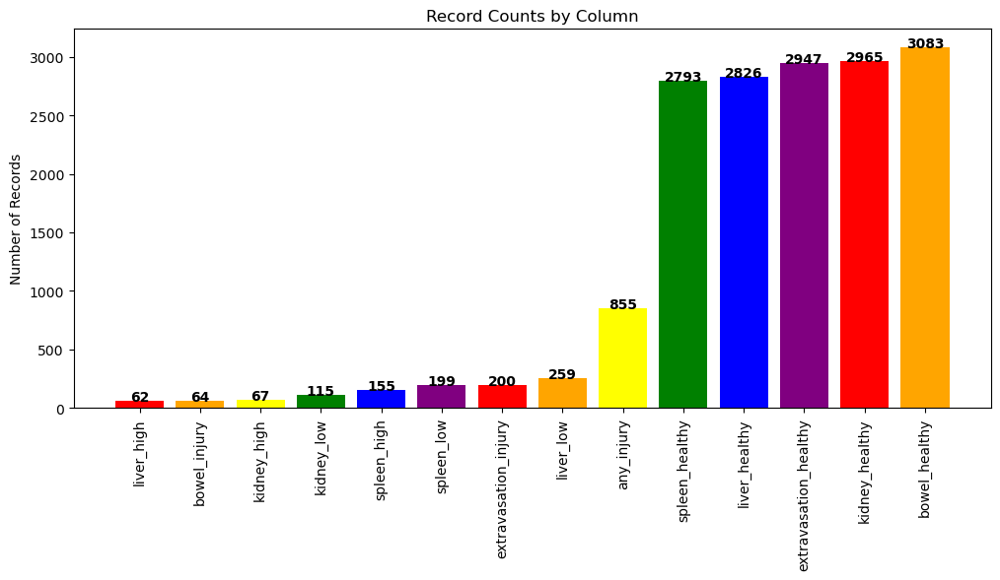

In [ ]:
# count the number of records in each column
sum_ = train_labels.iloc[:,1:].sum()

# sort the counts in ascending order
sum_sorted = sum_.sort_values()

plt.figure(figsize=(12, 5))
# create a bar plot of the sorted counts with color
plt.bar(sum_sorted.index, sum_sorted, color=['red', 'orange', 'yellow', 'green', 'blue', 'purple'])
for i, v in enumerate(sum_sorted):
    plt.text(i, v, str(v), color='black', fontweight='bold', ha='center')

# add labels and title
plt.xticks(rotation='vertical')
plt.ylabel('Number of Records')
plt.title('Record Counts by Column')

# display the plot
plt.show()

**In summury, there are 3,147 observations :**

1. Of these, 855 abdominal injuries belong to any injury
2. Of these, 259 abdominal injuries belong to liver low
3. Of these, 200 abdominal injuries belong to extravasation injury
4. Of these, 199 abdominal injuries belong to spleen low
5. Of these, 155 abdominal injuries belong to kidney low
6. Of these, 67 abdominal injuries belong to kidney high
7. Of these, 64 abdominal injuries belong to bowel injury
8. Of these, 62 abdominal injuries belong to liver high

**LOAD & VIEW TRAIN SERIES META (In CSV format)**

In [ ]:
train_series_meta = pd.read_csv(os.path.join(dsroot, 'train_series_meta.csv'))
train_series_meta.shape

(4711, 4)

In [ ]:
train_series_meta.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4711 entries, 0 to 4710
Data columns (total 4 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   patient_id        4711 non-null   int64  
 1   series_id         4711 non-null   int64  
 2   aortic_hu         4711 non-null   float64
 3   incomplete_organ  4711 non-null   int64  
dtypes: float64(1), int64(3)
memory usage: 147.3 KB


In [ ]:
train_series_meta.head()

,patient_id,series_id,aortic_hu,incomplete_organ
0,10004,21057,146.00,0
1,10004,51033,454.75,0
2,10005,18667,187.00,0
3,10007,47578,329.00,0
4,10026,29700,327.00,0


In [ ]:
# Show all duplicates in patient id
train_series_meta.patient_id.duplicated().sum()

1564

In [ ]:
# Show all duplicates in patient id
train_series_meta.aortic_hu.duplicated().sum()

3994

In [ ]:
train_series_meta.nunique()

patient_id          3147
series_id           4711
aortic_hu            717
incomplete_organ       2
dtype: int64

In [ ]:
train_series_meta.pivot_table('patient_id', 'incomplete_organ',
                               aggfunc='count', margins =True, fill_value=0)

,patient_id
incomplete_organ,
0,4398
1,313
All,4711


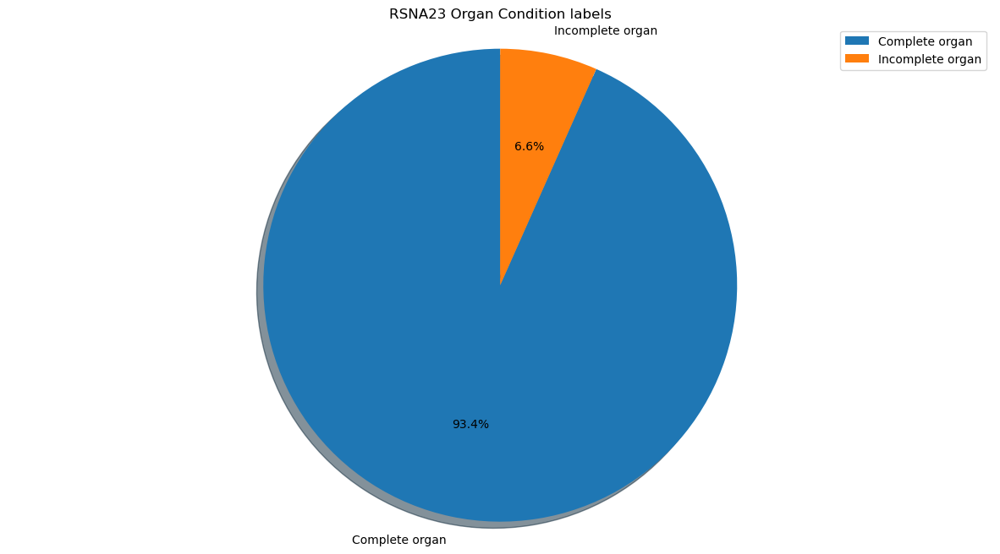

In [ ]:
# Plot pie chart
labels = ['Complete organ', 'Incomplete organ']
sizes = train_series_meta.incomplete_organ.value_counts()

fig1, ax1 = plt.subplots(figsize=(15,8))
ax1.pie(sizes, labels = labels, autopct='%1.1f%%', shadow = True, startangle=90)
ax1.axis('equal')
ax1.legend()

plt.title('RSNA23 Organ Condition labels')
plt.show()

In [ ]:
# Counting the unique values forincomplete_organ
train_series_meta['incomplete_organ'].value_counts()

incomplete_organ
0    4398
1     313
Name: count, dtype: int64

-----------

**In sum, there are 4711 observations or records**:

    1. Of these, 3,147 unique ID code for each patients
    2. Of these, 4,711 unique ID code for each scan
    3. Of these, 717 images
    4. Of these, 2 binary variable - Thrue if one or more organs was not fully covered by the scan
    5. Of these, 1,564 duplicates ID code - Maybe these patient have been scanned twice
    6. Of these, 3,994 aortic_hu duplicates -Indicate duplicate volume of the aorta was taken.
    7. Of these, 4,398 (93.4%) patient which the organ was fully covered by the scan.
    8. Of these, 313 (6.6%) patient which one or more organs was not fully covered by the scan.

**LOAD & VIEW TRAIN DICOM TAGS (In PARQUET format)**

In [ ]:
train_dicom_tags = pd.read_parquet(os.path.join(dsroot, 'train_dicom_tags.parquet'))
train_dicom_tags.shape

(1510373, 35)

In [ ]:
train_dicom_tags.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1510373 entries, 0 to 1510372
Data columns (total 35 columns):
 #   Column                      Non-Null Count    Dtype  
---  ------                      --------------    -----  
 0   BitsAllocated               1510373 non-null  int64  
 1   BitsStored                  1510373 non-null  int64  
 2   Columns                     1510373 non-null  int64  
 3   ContentDate                 1510373 non-null  object 
 4   ContentTime                 1510373 non-null  object 
 5   FrameOfReferenceUID         1510373 non-null  object 
 6   HighBit                     1510373 non-null  int64  
 7   ImageOrientationPatient     1510373 non-null  object 
 8   ImagePositionPatient        1510373 non-null  object 
 9   InstanceNumber              1510373 non-null  int64  
 10  KVP                         1510373 non-null  float64
 11  PatientID                   1510373 non-null  object 
 12  PatientPosition             1510373 non-null  object 
 1

In [ ]:
train_dicom_tags.head()

,BitsAllocated,BitsStored,Columns,ContentDate,ContentTime,FrameOfReferenceUID,HighBit,ImageOrientationPatient,ImagePositionPatient,InstanceNumber,...,WindowCenter,WindowWidth,FileMetaInformationVersion,ImplementationClassUID,ImplementationVersionName,MediaStorageSOPClassUID,MediaStorageSOPInstanceUID,TransferSyntaxUID,path,RescaleType
0,16,16,512,20230722,003306.881589,1.2.826.0.1.3680043.8.498.28466454913303094199...,15,"[1.00000, 0.00000, 0.00000, 0.00000, 1.00000, ...","[-235.8665, -235.8665, 1459.20]",532,...,50.0,400.0, ,1.2.3.123456.4.5.1234.1.12.0,PYDICOM 2.4.0,1.2.840.10008.5.1.4.1.1.2,1.2.123.12345.1.2.3.49954.1.532,1.2.840.10008.1.2.5,train_images/49954/41479/532.dcm,nan
1,16,16,512,20230722,003303.279137,1.2.826.0.1.3680043.8.498.28466454913303094199...,15,"[1.00000, 0.00000, 0.00000, 0.00000, 1.00000, ...","[-235.8665, -235.8665, 1474.40]",513,...,50.0,400.0, ,1.2.3.123456.4.5.1234.1.12.0,PYDICOM 2.4.0,1.2.840.10008.5.1.4.1.1.2,1.2.123.12345.1.2.3.49954.1.513,1.2.840.10008.1.2.5,train_images/49954/41479/513.dcm,nan
2,16,16,512,20230722,003343.090736,1.2.826.0.1.3680043.8.498.28466454913303094199...,15,"[1.00000, 0.00000, 0.00000, 0.00000, 1.00000, ...","[-235.8665, -235.8665, 1310.40]",718,...,50.0,400.0, ,1.2.3.123456.4.5.1234.1.12.0,PYDICOM 2.4.0,1.2.840.10008.5.1.4.1.1.2,1.2.123.12345.1.2.3.49954.1.718,1.2.840.10008.1.2.5,train_images/49954/41479/718.dcm,nan
3,16,16,512,20230722,003252.960345,1.2.826.0.1.3680043.8.498.28466454913303094199...,15,"[1.00000, 0.00000, 0.00000, 0.00000, 1.00000, ...","[-235.8665, -235.8665, 1520.00]",456,...,50.0,400.0, ,1.2.3.123456.4.5.1234.1.12.0,PYDICOM 2.4.0,1.2.840.10008.5.1.4.1.1.2,1.2.123.12345.1.2.3.49954.1.456,1.2.840.10008.1.2.5,train_images/49954/41479/456.dcm,nan
4,16,16,512,20230722,003155.059398,1.2.826.0.1.3680043.8.498.28466454913303094199...,15,"[1.00000, 0.00000, 0.00000, 0.00000, 1.00000, ...","[-235.8665, -235.8665, 1756.00]",161,...,50.0,400.0, ,1.2.3.123456.4.5.1234.1.12.0,PYDICOM 2.4.0,1.2.840.10008.5.1.4.1.1.2,1.2.123.12345.1.2.3.49954.1.161,1.2.840.10008.1.2.5,train_images/49954/41479/161.dcm,nan


In [ ]:
train_dicom_tags.nunique()

BitsAllocated                       1
BitsStored                          3
Columns                           136
ContentDate                         2
ContentTime                   1508830
FrameOfReferenceUID              3147
HighBit                             3
ImageOrientationPatient           173
ImagePositionPatient          1426166
InstanceNumber                   1971
KVP                                10
PatientID                        3147
PatientPosition                     2
PhotometricInterpretation           1
PixelRepresentation                 2
PixelSpacing                      807
RescaleIntercept                    4
RescaleSlope                        1
Rows                                6
SOPInstanceUID                1210859
SamplesPerPixel                     1
SeriesInstanceUID                4771
SeriesNumber                      134
SliceThickness                     19
StudyInstanceUID                 3147
WindowCenter                        1
WindowWidth 

------------

**LOAD & VIEW IMAGE LEVEL LABELS (In CSV format)**

In [ ]:
image_level_labels = pd.read_csv(os.path.join(dsroot, 'image_level_labels.csv'))
image_level_labels.shape

(12029, 4)

In [ ]:
image_level_labels.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12029 entries, 0 to 12028
Data columns (total 4 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   patient_id       12029 non-null  int64 
 1   series_id        12029 non-null  int64 
 2   instance_number  12029 non-null  int64 
 3   injury_name      12029 non-null  object
dtypes: int64(3), object(1)
memory usage: 376.0+ KB


In [ ]:
image_level_labels.head()

,patient_id,series_id,instance_number,injury_name
0,10004,21057,362,Active_Extravasation
1,10004,21057,363,Active_Extravasation
2,10004,21057,364,Active_Extravasation
3,10004,21057,365,Active_Extravasation
4,10004,21057,366,Active_Extravasation


In [ ]:
# Show all duplicates in patient id
image_level_labels.patient_id.duplicated().sum()

11783

In [ ]:
# Show all duplicates in series id
image_level_labels.series_id.duplicated().sum()

11699

In [ ]:
# Show all duplicates in instance number
image_level_labels.instance_number.duplicated().sum()

11104

In [ ]:
image_level_labels.nunique()

patient_id         246
series_id          330
instance_number    925
injury_name          2
dtype: int64

--------

**In sum, there are 12029 observations or records**:

    1. Of these, 246 patients
    2. Of these, 330 series
    3. Of these, 925 images
    4. Of these, 2 types of Injuries
    5. Of these, 11,783 duplicates patient_id - Maybe these patient have been scanned twice
    6. Of these, 11,699 duplicates series id - this indicate some scan were done more than twice.
    7. Of these, 11,104 duplicates image instance number -this indicate same image # was assigned more than one.

In [ ]:
image_level_labels.pivot_table('patient_id', 'injury_name',
                               aggfunc='count', margins =True, fill_value=0)

,patient_id
injury_name,
Active_Extravasation,6370
Bowel,5659
All,12029


In [ ]:
grp_patientid_by_seriesid =image_level_labels.groupby('patient_id')['series_id'].nunique().sum()

In [ ]:
grp_patientid_by_seriesid

330

In [ ]:
grp_patientid_by_instance =image_level_labels.groupby('patient_id')['instance_number'].nunique().sum()

In [ ]:
grp_patientid_by_instance

10705

In [ ]:
grp_seriesid_by_instance =image_level_labels.groupby('series_id')['instance_number'].nunique().sum()

In [ ]:
grp_seriesid_by_instance

11536

**LOAD & VIEW SAMPLE SUBMISSION (In CSV format)**

In [ ]:
sample_submission = pd.read_csv(os.path.join(dsroot, 'sample_submission.csv'))
sample_submission.shape

(3, 14)

In [ ]:
sample_submission.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3 entries, 0 to 2
Data columns (total 14 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   patient_id             3 non-null      int64  
 1   bowel_healthy          3 non-null      float64
 2   bowel_injury           3 non-null      float64
 3   extravasation_healthy  3 non-null      float64
 4   extravasation_injury   3 non-null      float64
 5   kidney_healthy         3 non-null      float64
 6   kidney_low             3 non-null      float64
 7   kidney_high            3 non-null      float64
 8   liver_healthy          3 non-null      float64
 9   liver_low              3 non-null      float64
 10  liver_high             3 non-null      float64
 11  spleen_healthy         3 non-null      float64
 12  spleen_low             3 non-null      float64
 13  spleen_high            3 non-null      float64
dtypes: float64(13), int64(1)
memory usage: 468.0 bytes


In [ ]:
sample_submission.head()

,patient_id,bowel_healthy,bowel_injury,extravasation_healthy,extravasation_injury,kidney_healthy,kidney_low,kidney_high,liver_healthy,liver_low,liver_high,spleen_healthy,spleen_low,spleen_high
0,48843,0.5,0.5,0.5,0.5,0.333333,0.333333,0.333333,0.333333,0.333333,0.333333,0.333333,0.333333,0.333333
1,50046,0.5,0.5,0.5,0.5,0.333333,0.333333,0.333333,0.333333,0.333333,0.333333,0.333333,0.333333,0.333333
2,63706,0.5,0.5,0.5,0.5,0.333333,0.333333,0.333333,0.333333,0.333333,0.333333,0.333333,0.333333,0.333333


In [ ]:
test_dicom_tags = pd.read_parquet(os.path.join(dsroot, 'test_dicom_tags.parquet'))
test_dicom_tags.shape

(3, 35)

In [ ]:
test_dicom_tags.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3 entries, 0 to 2
Data columns (total 35 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   BitsAllocated               3 non-null      int64  
 1   BitsStored                  3 non-null      int64  
 2   Columns                     3 non-null      int64  
 3   ContentDate                 3 non-null      object 
 4   ContentTime                 3 non-null      object 
 5   FrameOfReferenceUID         3 non-null      object 
 6   HighBit                     3 non-null      int64  
 7   ImageOrientationPatient     3 non-null      object 
 8   ImagePositionPatient        3 non-null      object 
 9   InstanceNumber              3 non-null      int64  
 10  KVP                         3 non-null      float64
 11  PatientID                   3 non-null      object 
 12  PatientPosition             3 non-null      object 
 13  PhotometricInterpretation   3 non-null 

#### As shown above, test & the submission data has only three (3) observations or records.

**PREPROCESS SEGMENTATIONS IMAGES (In nibabel format -3D image)**

In [ ]:
import SimpleITK as sitk # for nifti files
import matplotlib.pyplot as plt

# Define the directory containing the medical images
ni_img_dir= os.path.join(dsroot, f'segmentations/')

# Get the list of image file names in the directory
image_files = os.listdir(ni_img_dir)
print('There a total of', len(image_files), 'images stored in nibabel format')

There a total of 206 images stored in nibabel format


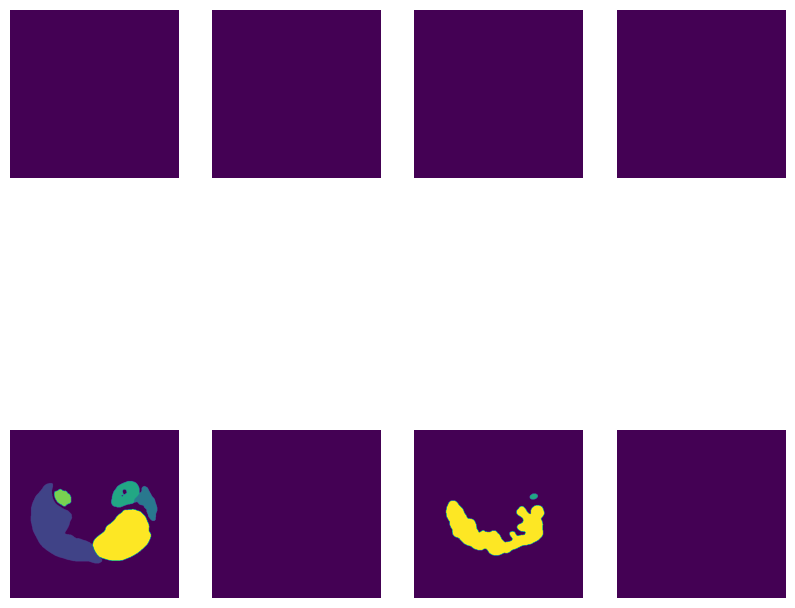

In [ ]:
# Plot 8medical image using SimpleITK and Matplotlib
plt.figure(figsize=(10, 10))

for i in range(8):
    image_path = os.path.join(ni_img_dir, image_files[i])
    image = sitk.ReadImage(image_path)
    image_array = sitk.GetArrayFromImage(image)
    plt.subplot(2, 4, i+1)  # Create a 2x3 grid of subplots
    plt.imshow(image_array[0])
    plt.axis("off")  # Optional: Remove the axis labels

plt.show()

---------------

**_As seen above, it's worth noting that the image mask technique (segmentation) was used to remove noise and irrelevant information to focus on the relevant parts of the image. On 2 images out of 8 show the region of interest (ROI).Here are some of the main benefits of using image masks in medical image analysis_:**

      1. Precise analysis: Image masks allow for a more precise analysis of anatomical data by isolating only necessary areas. This is particularly useful for certain procedures, such as implant design, where it is necessary to segment out certain structures, for example in the hip or knee, heart, etc.
    
      2. Noise reduction: Medical images often contain a lot of noise and irrelevant information. Image masks help to remove this noise and focus on the relevant parts of the image. This helps to improve the accuracy and reliability of the analysis by reducing the influence of irrelevant information.
    
     3. Standardization: Image masks help to standardize the images by removing variations in background and lighting conditions. This is important for ensuring consistency in the analysis and reducing the impact of confounding factors.
   
     4. Time-saving: Image masks can speed up the analysis process by reducing the amount of manual intervention required. This is particularly true for deep learning-based approaches, where image masks can be used to train models more efficiently.
    
     5. Pin-point accuracy: Image masks offer the benefit of pin-point accuracy, allowing different tissues such as bone and soft tissues to be isolated. This is particularly useful for certain procedures, such as tumor detection and organ segmentation.

**_In summary, image masks are an essential tool in medical image analysis, offering numerous benefits such as precise analysis, noise reduction, standardization, time-saving, and pin-point accuracy_.**

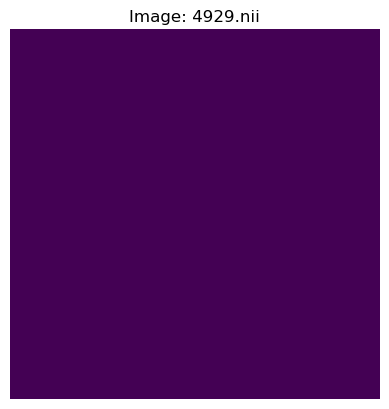

In [ ]:
# Loop into the directory and break the loop at 50 CT scan images and display the fist one

for filename in os.listdir(ni_img_dir):
    if filename.endswith('.nii'):
        filepath = os.path.join(ni_img_dir, filename)
        img = nib.load(filepath)
        data = img.get_fdata()

        # Display the first slice of the image
        plt.imshow(data[:, :, 0])
        plt.title(f"Image: {filename}")
        plt.axis('off')
        plt.show()

        # Stop after reading 50 images
        if len(os.listdir(ni_img_dir)) >= 50:
            break

------------

**_The above CT scan image shows that the image has uniform texture.This image contains a uniform background or a uniform object,or has low contrast, meaning that the difference between the brightest and darkest pixels is small_**.

**_Overall, the interpretation of the above CT scan image depends on the context of the image and the application. In some cases, it may be desirable, while in other cases it may indicate a problem with the image quality or the preprocessing steps_**

**_However, it will be wise to talk to a medical professional or consult a domain expert when working with medical images, as they can provide valuable insights and guidance_**.

------------

**_PREPROCESS TRAIN IMAGES (In dycom format - 2D images)_**

------

In [ ]:
# specify the directory path for train_images
img_src_dir = '/home/mukwa/Desktop/rsna-2023-abdominal-trauma-detection/train_images'

# initialize counters
num_images = 0
num_series = 0
num_patients = 0
patient_ids = set()

# start the timer
start_time = time.time()

# loop through the directory tree using os.walk()
for root, dirs, files in os.walk(img_src_dir):
    for file in files:
        if file.endswith(".dcm"):
            # read the DICOM file using pydicom
            ds = dicom.dcmread(os.path.join(root, file))
            # check if the NumberOfFrames attribute is present
            if hasattr(ds, "NumberOfFrames"):
                # increment the image counter by the number of frames in the file
                num_images += ds.NumberOfFrames
            else:
                # increment the image counter by 1 for single-frame images
                num_images += 1
            # increment the series counter if this is the first image in the series
            if ds.SeriesNumber == 1:
                num_series += 1
            # add the patient ID to the set of patient IDs
            patient_ids.add(ds.PatientID)

# count the number of unique patient IDs
num_patients = len(patient_ids)

# stop the timer
end_time = time.time()

# calculate the processing time in minutes and seconds
processing_time = end_time - start_time
processing_time_minutes = int(processing_time // 60)
processing_time_seconds = int(processing_time % 60)

# print the results
print("Number of DICOM images:", num_images)
print("Number of series:", num_series)
print("Number of patients:", num_patients)
print("Processing time:", processing_time_minutes, "minutes", processing_time_seconds, "seconds")


Number of DICOM images: 1500653
Number of series: 57572
Number of patients: 3147
Processing time: 22 minutes 59 seconds


In [ ]:
# Initialize the counters for 1 and 2 subfolders
one_sub = 0
two_sub = 0

# Loop through the folders (patient_id) in the main directory
for folder in os.listdir(img_src_dir):
    # Get the full path of the folder
    folder_path = os.path.join(img_src_dir, folder)
    # Check if the folder (patient_id) is a directory
    if os.path.isdir(folder_path):
        # Get the list of subfolders (series_id)in the folder (patient_id)
        subfolders = os.listdir(folder_path)
        # Count the number of subfolders
        num_sub = len(subfolders)
        # Update the counters accordingly
        if num_sub == 1:
            one_sub += 1
        elif num_sub == 2:
            two_sub += 1

# Print the results
print('\n'f'There are {one_sub} patient_id with 1 series_id in train_images directory')
print(f'There are {two_sub} patient_id with 2 series_id in train_images directory')


There are 1583 patient_id with 1 series_id in train_images directory
There are 1564 patient_id with 2 series_id in train_images directory


-----------------------------

## Read a DICOM image:

**_DICOM is the international standard for medical images and related information. It defines the formats for medical images that can be exchanged with the data and quality necessary for clinical use. DICOM stands for Digital Imaging and Communications in Medicine and is recognized by the International Organization for Standardization as the ISO 12052 standard. DICOM is the standard format for most medical imaging devices used in hospitals and clinical care settings, including MRI, PET, CT, Xray, and ultrasound. For this reason, it is common that raw MRI data comes off the scanner in DICOM format_**.

---------------------------------------

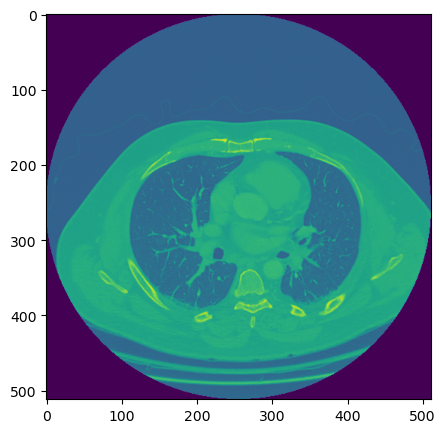

In [ ]:
# Load the DICOM 2D image 229
slice_im19 = dicom.dcmread(os.path.join(dsroot, f'train_images/19/14374/229.dcm'))

# Get the pixel data
im_pixel = slice_im19.pixel_array

# Display the image
plt.figure(figsize=(5, 5))
plt.imshow(im_pixel)

# Plot images 229.dcm
plt.show()

**_We can clean the image up by using a greyscale colour map, and removing the numerical axis labels.This time we use the bone colourmap, which is another monochrome palette but with a slight blueish hue:_**

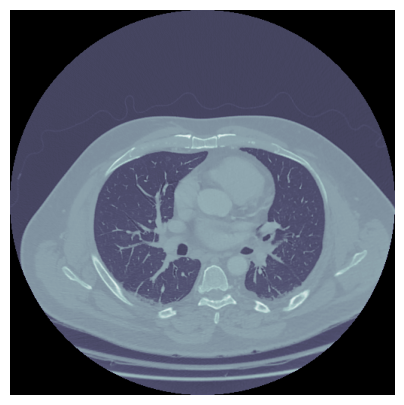

In [ ]:
# Display the image in a gratscale color map
plt.figure(figsize=(5, 5))
plt.imshow(im_pixel, cmap='bone')

# Optional: Remove the axis labels
plt.axis('off')
# Plot images 229.dcm
plt.show()

**_Below is the visualization within 4 differents colors including high contrast_**

DICOM file contained compressed data. Autoconverting with gdcmconv (this warning is shown once for each directory)


gdcmconv: gdcm 3.0.22 $Date$


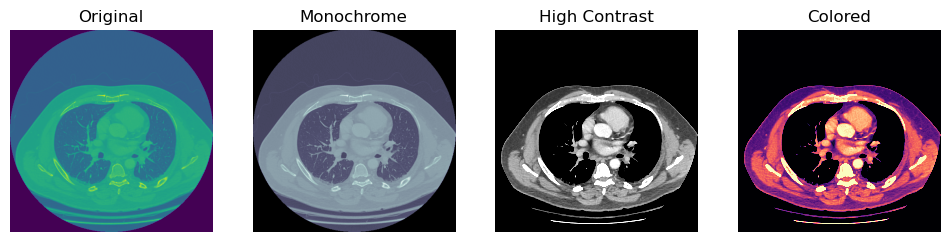

In [ ]:
# Read single DICOM image with imread
im = iio.imread(os.path.join(dsroot, f'train_images/19/14374/229.dcm'))

# Plot three versions of chest dcm with image transformations
plt.rcParams['figure.figsize'] = (12, 8)

fig, axes = plt.subplots(nrows= 1, ncols= 4)
axes[0].imshow(im)
axes[1].imshow(im, cmap= 'bone')
axes[2].imshow(im, vmin= -200, vmax= 200, cmap= 'gray')
axes[3].imshow(im, vmin= -200, vmax= 200, cmap= 'magma')
axes[0].set_title('Original')
axes[1].set_title('Monochrome')
axes[2].set_title('High Contrast')
axes[3].set_title('Colored')
for ax in axes:
  ax.axis('off')
plt.show()

**_As seen above, a single 2D image does not provide any detailed insight. It will be wise to retrieve more 2D images for this patient for better CT scan images analysis_**

-----------------

gdcmconv: gdcm 3.0.22 $Date$
gdcmconv: gdcm 3.0.22 $Date$
gdcmconv: gdcm 3.0.22 $Date$
gdcmconv: gdcm 3.0.22 $Date$
gdcmconv: gdcm 3.0.22 $Date$


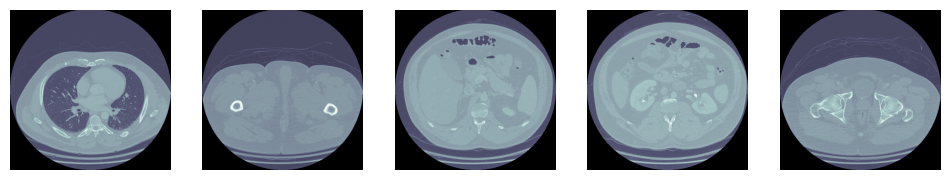

In [ ]:
# Define the directory containing the medical images
img19_fpath = os.path.join(dsroot, f'train_images/19/14374')

# Get the list of image file names in the directory
image19_files = os.listdir(img19_fpath)

# Load and plot each image
plt.figure(figsize=(12, 12))

for i in range(5):
    image19_path = os.path.join(img19_fpath, image19_files[i])
    image19 = iio.imread(image19_path)
    plt.subplot(1,5, i+1)  # Create a 2x3 grid of subplots
    plt.imshow(image19, cmap='bone')
    plt.axis("off")  # Optional: Remove the axis labels

plt.show()

DICOM file contained compressed data. Autoconverting with gdcmconv (this warning is shown once for each directory)


gdcmconv: gdcm 3.0.22 $Date$
gdcmconv: gdcm 3.0.22 $Date$
gdcmconv: gdcm 3.0.22 $Date$
gdcmconv: gdcm 3.0.22 $Date$
gdcmconv: gdcm 3.0.22 $Date$
gdcmconv: gdcm 3.0.22 $Date$


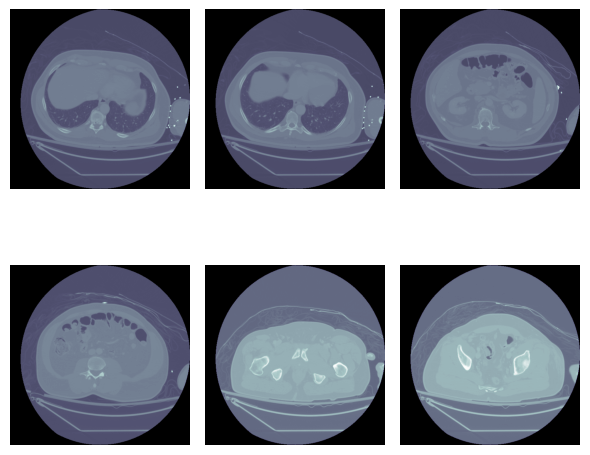

In [ ]:
# Define the directory containing the medical images
img_path = os.path.join(dsroot, f'train_images/64263/40690/')

# Get the list of image file names in the directory
img_files = os.listdir(img_path)

# Load and plot each image
plt.figure(figsize=(6, 6))

for i in range(6):
    image_fpath = os.path.join(img_path, img_files[i])
    image = iio.imread(image_fpath)
    plt.subplot(2,3, i+1)  # Create a 2x3 grid of subplots
    plt.imshow(image, cmap='bone')
    plt.axis("off")  # Optional: Remove the axis labels

plt.tight_layout()
plt.show()

**_The visualization (2D images/slices) only allows for a less detailed examination of each image but may not provide a comprehensive overview of the entire stacked 2D slices or all slices for the patient to dectect abdominal trauma_**

-------

**_FILTERS_:**

**_The aim of using filters is to help to visually modify or enhance image properties and identify different features present in an image like edges, as edges, corners, blobs, bends, etc_**.
**_This can help in understanding how filters modify or enhance image properties and extract valuable information from the pictures_**.

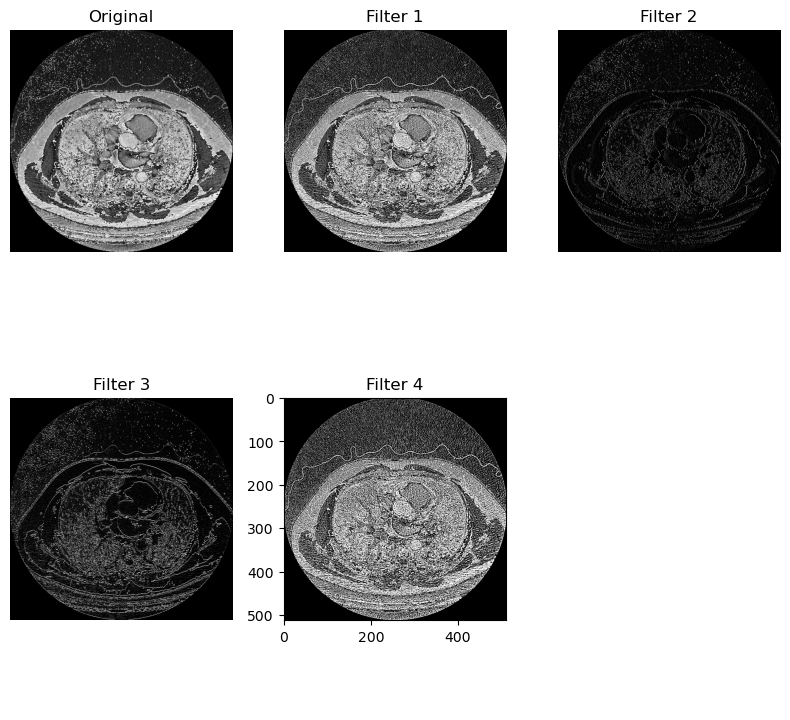

In [ ]:
# Load the DICOM 2D image 229
im19 = dicom.dcmread(os.path.join(dsroot, f'train_images/19/14374/229.dcm'))

# define the filters
filter1 = np.array([[0, -1, 0], [-1, 5, -1], [0, -1, 0]])
filter2 = np.array([[0, 0, 0], [-1, 1, 0], [0, 0, 0]])
filter3 = np.array([[0, -1, 0], [0, 2, 0], [0, -1, 0]])
filter4 = np.array([[-1, -1, -1], [-1, 9, -1], [-1, -1, -1]])

# extract the pixel data and convert to uint8
pixel_im = im19.pixel_array.astype("uint8")

# apply filters to the pixel data
filtered_data1 = cv2.filter2D(pixel_im, -1, filter1)
filtered_data2 = cv2.filter2D(pixel_im, -1, filter2)
filtered_data3 = cv2.filter2D(pixel_im, -1, filter3)
filtered_data4 = cv2.filter2D(pixel_im, -1, filter4)

# plot the original and filtered images
fig, axs = plt.subplots(2, 3, figsize=(8, 8))
axs[0, 0].imshow(pixel_im, cmap=plt.cm.gray)
axs[0, 0].set_title("Original")
axs[0, 0].axis('off')
axs[0, 1].imshow(filtered_data1, cmap=plt.cm.gray)
axs[0, 1].set_title("Filter 1")
axs[0, 1].axis('off')
axs[0, 2].imshow(filtered_data2, cmap=plt.cm.gray)
axs[0, 2].set_title("Filter 2")
axs[0, 2].axis('off')
axs[1, 0].imshow(filtered_data3, cmap=plt.cm.gray)
axs[1, 0].set_title("Filter 3")
axs[1, 0].axis('off')
axs[1, 1].imshow(filtered_data4, cmap=plt.cm.gray)
axs[1, 1].set_title("Filter 4")
axs[1, 2].axis('off')

plt.tight_layout()
plt.show()

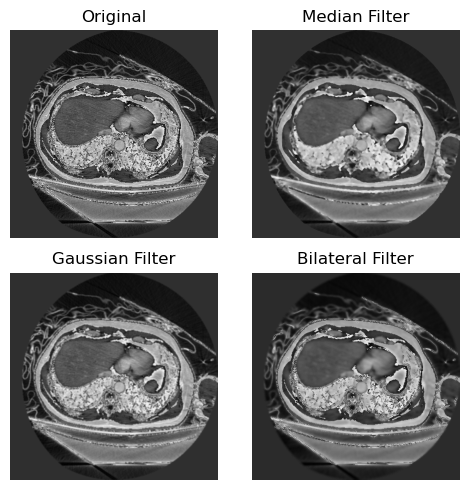

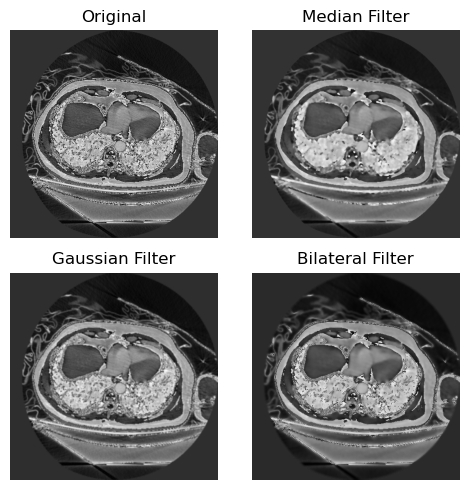

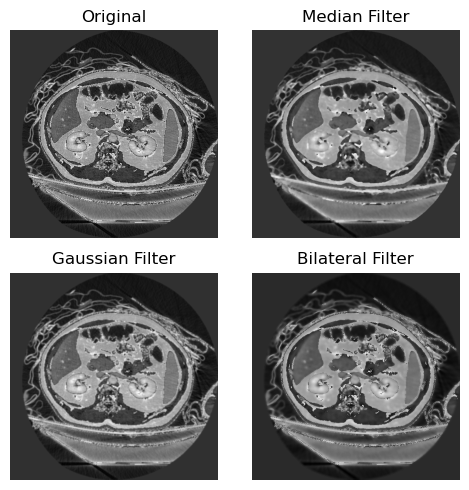

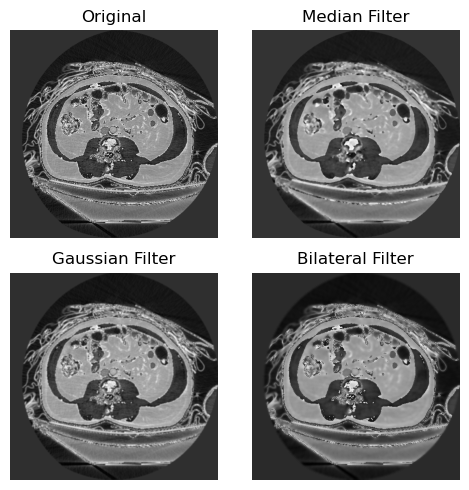

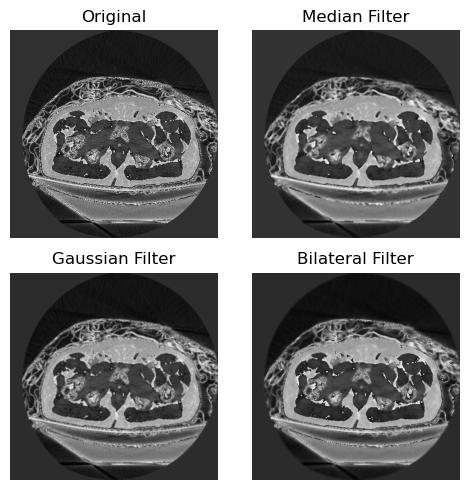

...

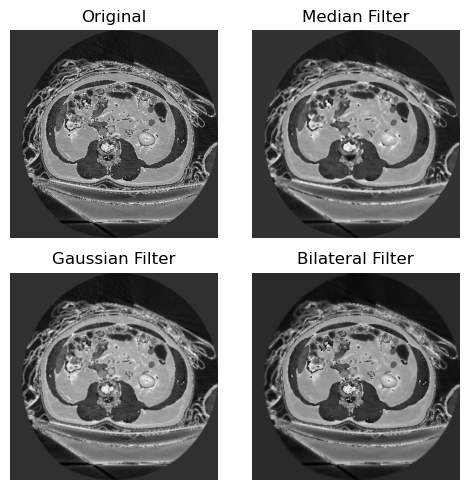

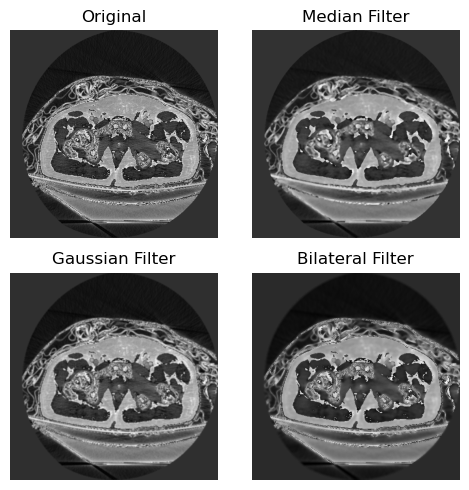

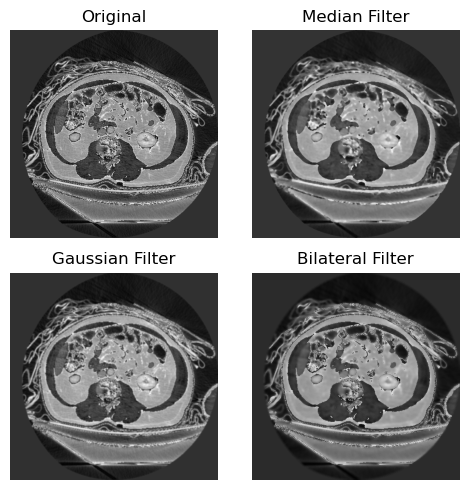

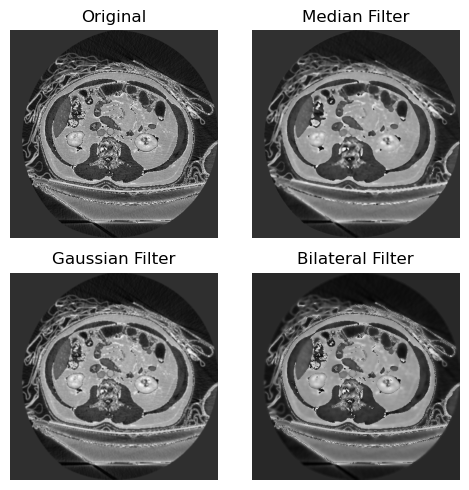

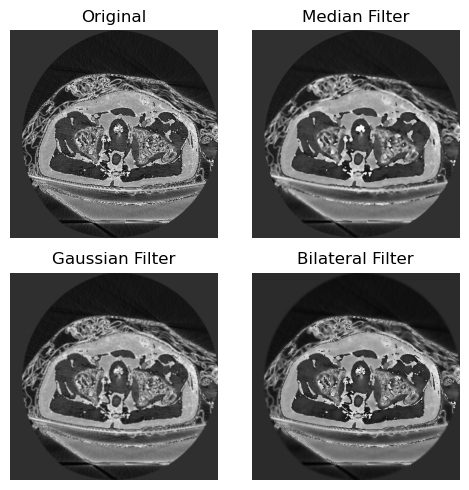

In [ ]:
# Define the directory containing the medical images
img_path = os.path.join(dsroot, f'train_images/64263/40690/')

# loop through the directory tree using os.walk()
for root, dirs, files in os.walk(img_path):
    for file in files:
        if file.endswith(".dcm"):
            # read the DICOM file using pydicom
            ds = dicom.dcmread(os.path.join(root, file))
            # extract the pixel data and convert to uint8
            pixel_data = ds.pixel_array.astype("uint8")
            # apply filters to the pixel data
            filtered_data1 = cv2.medianBlur(pixel_data, 5)
            filtered_data2 = cv2.GaussianBlur(pixel_data, (5, 5), 0)
            filtered_data3 = cv2.bilateralFilter(pixel_data, 9, 75, 75)
            # plot the original and filtered images
            fig, axs = plt.subplots(2, 2, figsize=(5, 5))
            axs[0, 0].imshow(pixel_data, cmap=plt.cm.gray)
            axs[0, 0].set_title("Original")
            axs[0, 0].axis('off')
            axs[0, 1].imshow(filtered_data1, cmap=plt.cm.gray)
            axs[0, 1].set_title("Median Filter")
            axs[0, 1].axis('off')
            axs[1, 0].imshow(filtered_data2, cmap=plt.cm.gray)
            axs[1, 0].set_title("Gaussian Filter")
            axs[1, 0].axis('off')
            axs[1, 1].imshow(filtered_data3, cmap=plt.cm.gray)
            axs[1, 1].set_title("Bilateral Filter")
            axs[1, 1].axis('off')
            plt.tight_layout()
            plt.show()

--------

**_As seen above, there are no inherent limitations to visualize only 2D images (slices) out of all slices for the patient. However,it is important to consider the context and purpose of the visualization. For example, if the goal is to compare the features of different images or regions, it may be necessary to visualize all images or a larger subset. In our case the 2D images we visualize don't provide any insights whatsover_**.

**_Additionally, the specific 2D images that are chosen for visualization are not representative of the entire image  or dataset, leading to potential biases in the analysis or interpretation of the results_**.

--------------------------------

# BIOMMEDICAL IMAGE ANALYSIS

**_Using stacked slices to extract other planes (Sagittal and Coronal) is really handy. Radiologists can also benefit from scrolling through many slices when diagnosing. However, in order to appropriately display the three planes (Axial, Sagital and Coronal) and scroll over slices, we, as AI engineers, must first comprehend the meaning of the various properties. These characteristics include sampling, shape, and aspect ratio_**.

**_Although there are many methods and libraries for analyzing biodemical or radiology images, for this project we will focus on imageio_**

**_It is worth noting that we are going to focus on the patient ID #19, serie_id #14374_**


---------------

## _Reading and Visualizing Structural 3D CT Scan images_

**_In this 3D CT scan image analysis part we will read structural CT scan or MRI images of Abdomen into Python, visualize them as slices, and perform a couple of simple image processing operations on images of patient 19_**.

In [ ]:
# Read the DICOM image using imageio.volread()
# Note: imageio.volread() can read a single file or a folder of files
id19_im_vol = iio.volread(img19_fpath,'DICOM')

Reading DICOM (examining files): 1/1346 files (0.1  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 1/1346 files (0.1  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 1/1346 files (0.1  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 1/1346 files (0.1  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 1/1346 files (0.1  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using d

Reading DICOM (examining files): 1/1346 files (0.1  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 1/1346 files (0.1  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 1/1346 files (0.1  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 1/1346 files (0.1  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 1/1346 files (0.1  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using d

Reading DICOM (examining files): 1/1346 files (0.1  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 1/1346 files (0.1  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 1/1346 files (0.1  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 1/1346 files (0.1  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 1/1346 files (0.1  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using d

Reading DICOM (examining files): 1/1346 files (0.1  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 1/1346 files (0.1  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 1/1346 files (0.1  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 1/1346 files (0.1  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 1/1346 files (0.1  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using d

Reading DICOM (examining files): 304/1346 files (22.6%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 304/1346 files (22.6%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 304/1346 files (22.6%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 304/1346 files (22.6%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 304/1346 files (22.6%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE).

Reading DICOM (examining files): 304/1346 files (22.6%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 304/1346 files (22.6%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 304/1346 files (22.6%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 304/1346 files (22.6%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 304/1346 files (22.6%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE).

Reading DICOM (examining files): 304/1346 files (22.6%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 304/1346 files (22.6%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 304/1346 files (22.6%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 304/1346 files (22.6%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 304/1346 files (22.6%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE).

Reading DICOM (examining files): 304/1346 files (22.6%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 304/1346 files (22.6%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 304/1346 files (22.6%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 304/1346 files (22.6%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 304/1346 files (22.6%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE).

Reading DICOM (examining files): 580/1346 files (43.1%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 580/1346 files (43.1%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 580/1346 files (43.1%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 580/1346 files (43.1%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 580/1346 files (43.1%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE).

Reading DICOM (examining files): 580/1346 files (43.1%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 580/1346 files (43.1%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 580/1346 files (43.1%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 580/1346 files (43.1%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 580/1346 files (43.1%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE).

Reading DICOM (examining files): 580/1346 files (43.1%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 580/1346 files (43.1%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 580/1346 files (43.1%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 580/1346 files (43.1%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 580/1346 files (43.1%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE).

Reading DICOM (examining files): 580/1346 files (43.1%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 580/1346 files (43.1%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 580/1346 files (43.1%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 580/1346 files (43.1%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 580/1346 files (43.1%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE).

Reading DICOM (examining files): 884/1346 files (65.7%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 884/1346 files (65.7%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 884/1346 files (65.7%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 884/1346 files (65.7%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 884/1346 files (65.7%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE).

Reading DICOM (examining files): 884/1346 files (65.7%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 884/1346 files (65.7%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 884/1346 files (65.7%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 884/1346 files (65.7%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 884/1346 files (65.7%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE).

Reading DICOM (examining files): 884/1346 files (65.7%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 884/1346 files (65.7%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 884/1346 files (65.7%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 884/1346 files (65.7%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 884/1346 files (65.7%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE).

Reading DICOM (examining files): 884/1346 files (65.7%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 884/1346 files (65.7%  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 884/1346 files (65.71197/1346 files (88.9  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 1197/1346 files (88.9  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 1197/1346 files (88.9  The dicom reader can only read files with uncompressed image data - not '1.2.840

Reading DICOM (examining files): 1197/1346 files (88.9  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 1197/1346 files (88.9  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 1197/1346 files (88.9  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 1197/1346 files (88.9  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 1197/1346 files (88.9  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE).

Reading DICOM (examining files): 1197/1346 files (88.9  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 1197/1346 files (88.9  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 1197/1346 files (88.9  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 1197/1346 files (88.9  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE). You can try using dcmtk or gdcm to convert the image.
Reading DICOM (examining files): 1197/1346 files (88.9  The dicom reader can only read files with uncompressed image data - not '1.2.840.10008.1.2.5' (RLE).

In [ ]:
# image attributes
id19_im_vol.meta

Dict([('TransferSyntaxUID', '1.2.840.10008.1.2.1'),
      ('SOPClassUID', '1.2.840.10008.5.1.4.1.1.2'),
      ('SOPInstanceUID', '1.2.123.12345.1.2.3.19.1.229'),
      ('ContentDate', '20230721'),
      ('ContentTime', '231217.173114 '),
      ('PatientID', '19'),
      ('StudyInstanceUID', '1.2.123.12345.1.2.3.19'),
      ('SeriesInstanceUID', '1.2.123.12345.1.2.3.19.14374'),
      ('SeriesNumber', 7),
      ('InstanceNumber', 229),
      ('ImagePositionPatient', (-228.0635, -221.2276, 1707.6)),
      ('ImageOrientationPatient', (1.0, 0.0, 0.0, 0.0, 1.0, 0.0)),
      ('SamplesPerPixel', 1),
      ('Rows', 512),
      ('Columns', 512),
      ('PixelSpacing', (0.904, 0.904)),
      ('BitsAllocated', 16),
      ('BitsStored', 16),
      ('HighBit', 15),
      ('PixelRepresentation', 1),
      ('RescaleIntercept', 0.0),
      ('RescaleSlope', 1.0),
      ('PixelData', b'Deferred loading of pixel data'),
      ('shape', (673, 512, 512)),
      ('sampling', (0.7999999999999998, 0.904, 0.904

In [ ]:
# plot interactive knee CT walkthrough
@widgets.interact(slice=(0,672))

def image19_dicom(slice = 0):
  fig, ax = plt.subplots(1,1, figsize = (5,5))
  ax.imshow(id19_im_vol[slice,:,:], cmap='bone')
  ax.axis('off')

interactive(children=(IntSlider(value=0, description='slice', max=672), Output()), _dom_classes=('widget-inter…

## _Visualize a slice through different planes_

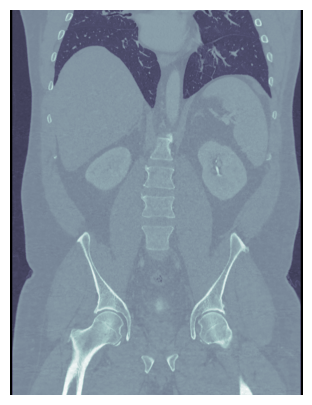

In [ ]:
plt.figure(figsize=(5, 5))
plt.imshow(id19_im_vol[:, 300], cmap='bone')
plt.axis('off')
plt.show()

## _Rotate the image_

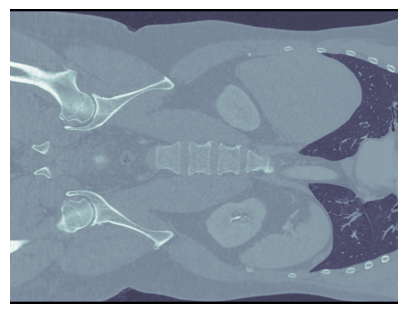

In [ ]:
plt.figure(figsize=(5, 5))
plt.imshow(ndi.rotate(id19_im_vol[:, 300], 270), cmap='bone')
plt.axis('off')
plt.show()

## _Coronal plane_

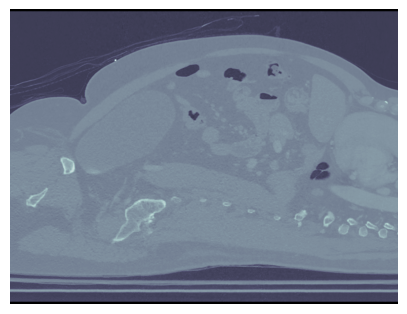

In [ ]:
plt.figure(figsize=(5, 5))
plt.imshow(ndi.rotate(id19_im_vol[:, :, 300], 270), cmap='bone')
plt.axis('off')
plt.show()

## _Plotting a series of slices through a volume_

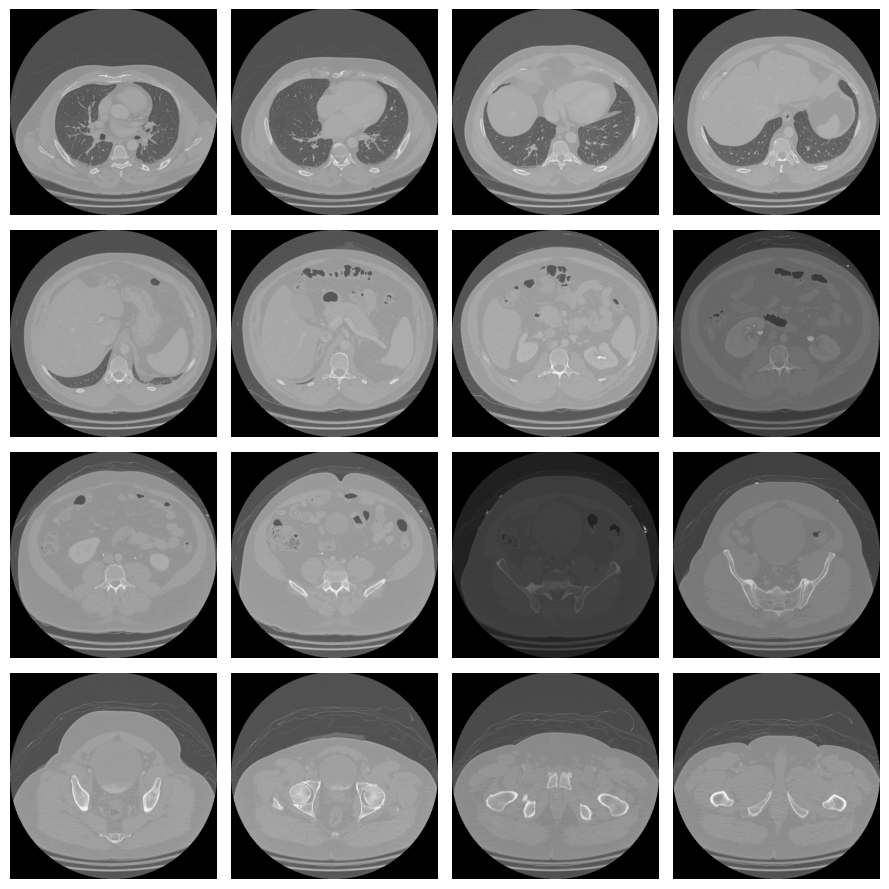

In [ ]:
fig_rows = 4
fig_cols = 4
n_subplots = fig_rows * fig_cols
n_slice = id19_im_vol.shape[0]
step_size = n_slice // n_subplots
plot_range = n_subplots * step_size
start_stop = int((n_slice - plot_range) / 2)

fig, axs = plt.subplots(fig_rows, fig_cols, figsize=[9, 9])
for idx, img in enumerate(range(start_stop, plot_range, step_size)):
    axs.flat[idx].imshow(id19_im_vol[img, :, :], cmap='gray')
    axs.flat[idx].axis('off')

plt.tight_layout()
plt.show()

## _Slice through a different axis_

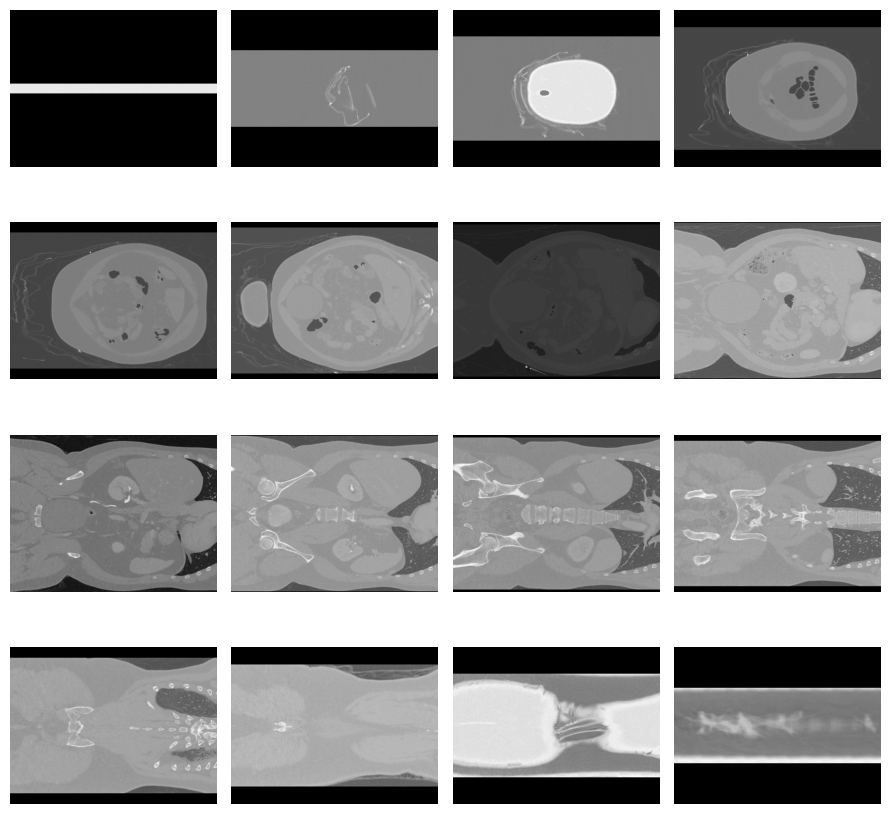

In [ ]:
n_slice = id19_im_vol.shape[1]
step_size = n_slice // n_subplots
plot_range = n_subplots * step_size
start_stop = int((n_slice - plot_range) / 2)

fig, axs = plt.subplots(fig_rows, fig_cols, figsize=[9, 9])
for idx, img in enumerate(range(start_stop, plot_range, step_size)):
    axs.flat[idx].imshow(ndi.rotate(id19_im_vol[:, img, :], 270), cmap='gray')
    axs.flat[idx].axis('off')

plt.tight_layout()
plt.show()

## _Coronal plane_

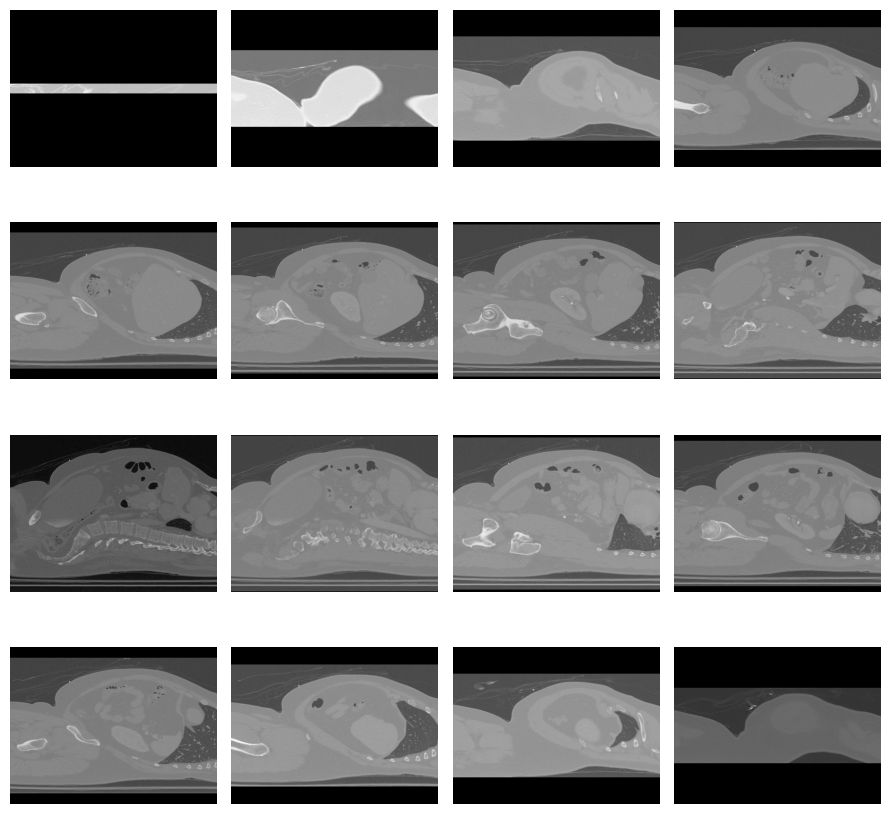

In [ ]:
fig_rows = 4
fig_cols = 4
n_subplots = fig_rows * fig_cols
n_slice = id19_im_vol.shape[2]
step_size = n_slice // n_subplots
plot_range = n_subplots * step_size

start_stop = int((n_slice - plot_range) / 2)

fig, axs = plt.subplots(fig_rows, fig_cols, figsize=[9, 9])
for idx, img in enumerate(range(start_stop, plot_range, step_size)):
    axs.flat[idx].imshow(ndi.rotate(id19_im_vol[:, :, img], 270), cmap='gray')
    axs.flat[idx].axis('off')

plt.tight_layout()
plt.show()

## _Plotting an image histogram_

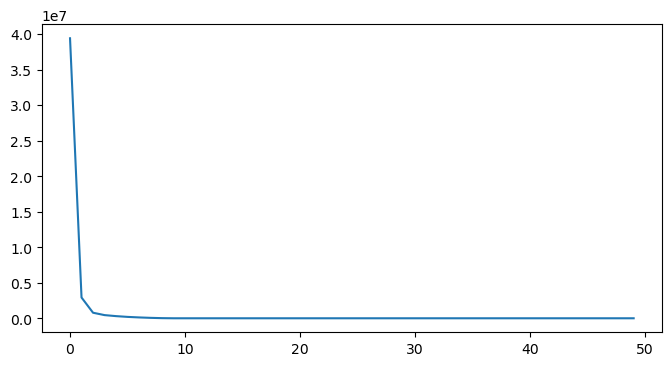

In [ ]:
plt.figure(figsize=(8, 4))
plt.plot(ndi.histogram(id19_im_vol, min=0, max=np.max(id19_im_vol), bins=50))
plt.show()

**_In summary, when the histogram of an image is smooth,it indicates that our image has a uniform textute, meaning that the pixel values are distributed more evenly across the image or an image contains a uniform background or a uniform object. This can have different interpretations depending on the context of the image and the application. Here are some possible interpretations_:**

  1. _The image has low contrast: A smooth histogram can indicate that the image has low contrast, meaning that the difference between the brightest and darkest pixels is small. This can happen, for example, when the image is underexposed or overexposed, or when the lighting conditions are poor_.
  2. _The image has uniform texture: A smooth histogram can also indicate that the image has uniform texture, meaning that the pixel values are similar across the image. This can happen, for example, when the image contains a uniform background or a uniform object_.

**_Overall, the interpretation of a smooth histogram depends on the context of the image and the application. In some cases, a smooth histogram may be desirable, while in other cases it may indicate a problem with the image quality or the preprocessing steps. Thus, tt will be wise medical professional or consult a domain expert when working with medical images, as they can provide valuable insights and guidance_**.

## _Mask an image_

In [ ]:
gm_min = ((np.max(id19_im_vol)) / 50) * 10
gm_max = ((np.max(id19_im_vol)) / 50) * 20

im19_mask1 = np.where(id19_im_vol > gm_min, 1, 0)
im19_mask2 = np.where(id19_im_vol < gm_max, 1, 0)

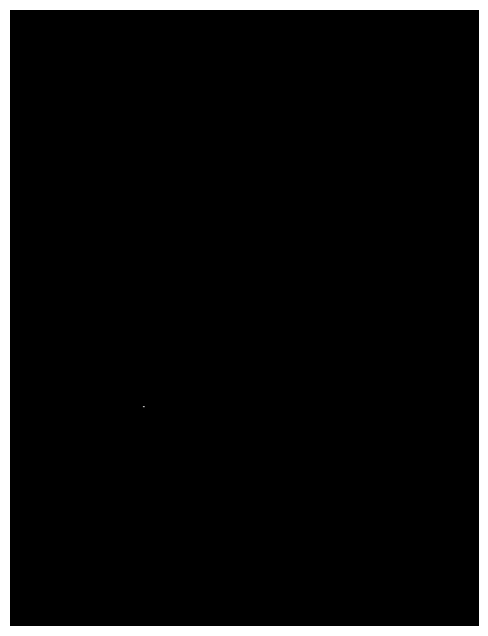

In [ ]:
im19_mask = im19_mask1 + im19_mask2
im19_mask = np.where(im19_mask == 2, 1, 0)

plt.imshow(im19_mask[:, 96, :], cmap='gray')
plt.axis('off')
plt.show()

## _Image smoothing_

**_Below we will apply Gaussian smoothing to our CT scan volume using ndimage’s gaussian_filter() function. The one argument we need to supply is sigma, which is the width of the smoothing kernel, expressed as units of standard deviation. A larger sigma value will result in a smoother (blurrier) image, because we average over a larger number of voxels_**.

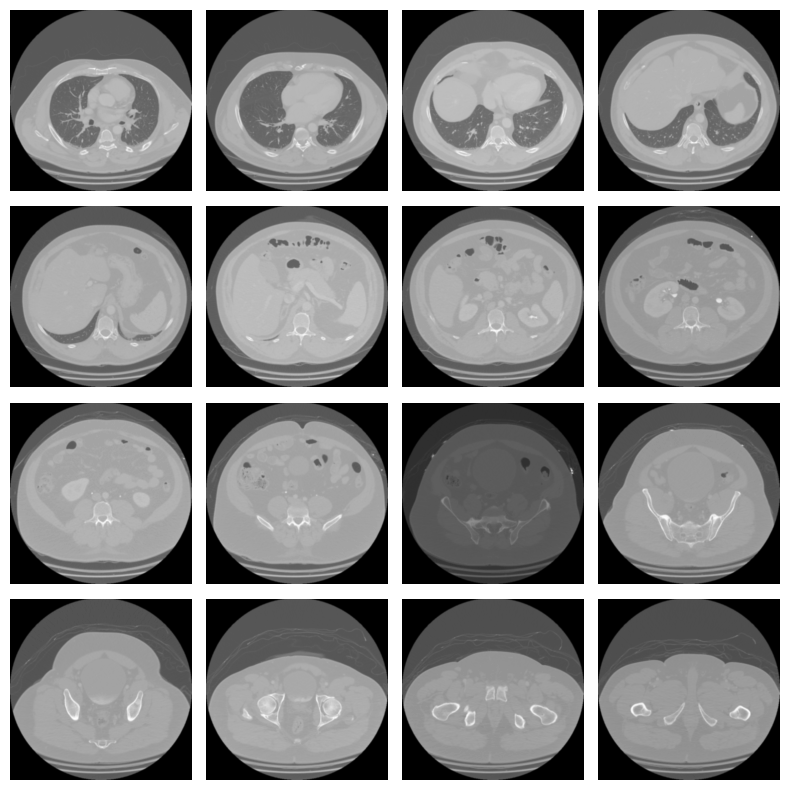

In [ ]:
# Set sigma to 1
sigma = 1
smoothed = ndi.gaussian_filter(id19_im_vol, sigma)

# plot the image witch we apply the filter
fig_rows = 4
fig_cols = 4
n_subplots = fig_rows * fig_cols
n_slice = id19_im_vol.shape[0]
step_size = n_slice // n_subplots
plot_range = n_subplots * step_size

start_stop = int((n_slice - plot_range) / 2)
fig, axs = plt.subplots(fig_rows, fig_cols, figsize=[8, 8])

for idx, img in enumerate(range(start_stop, plot_range, step_size)):
    axs.flat[idx].imshow(smoothed[img, :, :], cmap='gray')
    axs.flat[idx].axis('off')

plt.tight_layout()
plt.show()

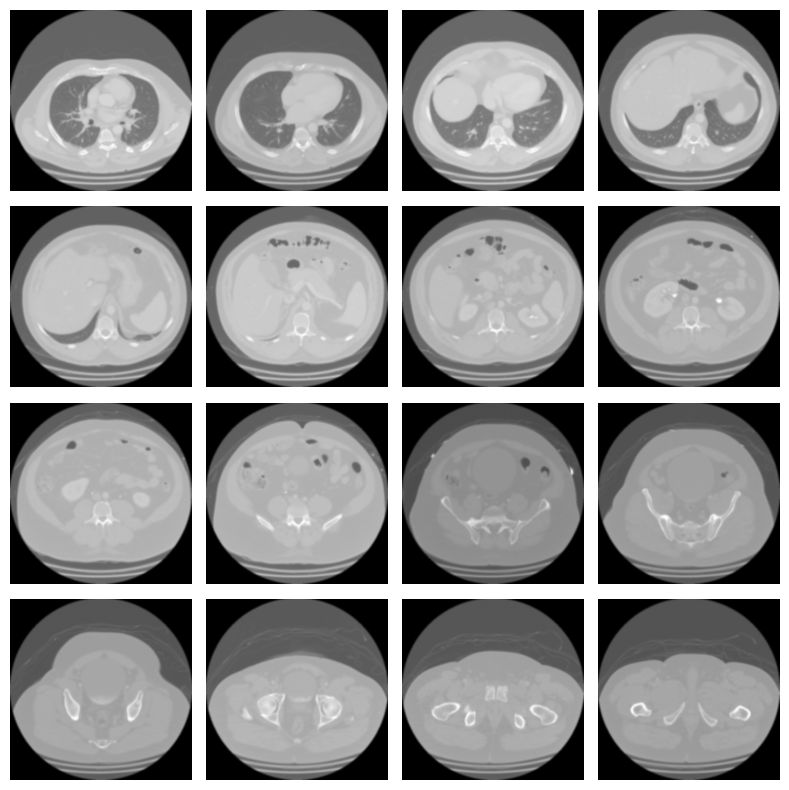

In [ ]:
# Set sigma to 2
sigma = 2
smoothed = ndi.gaussian_filter(id19_im_vol, sigma)

# plot the image witch we apply the filter
fig_rows = 4
fig_cols = 4
n_subplots = fig_rows * fig_cols
n_slice = id19_im_vol.shape[0]
step_size = n_slice // n_subplots
plot_range = n_subplots * step_size

start_stop = int((n_slice - plot_range) / 2)
fig, axs = plt.subplots(fig_rows, fig_cols, figsize=[8, 8])

for idx, img in enumerate(range(start_stop, plot_range, step_size)):
    axs.flat[idx].imshow(smoothed[img, :, :], cmap='gray')
    axs.flat[idx].axis('off')

plt.tight_layout()
plt.show()

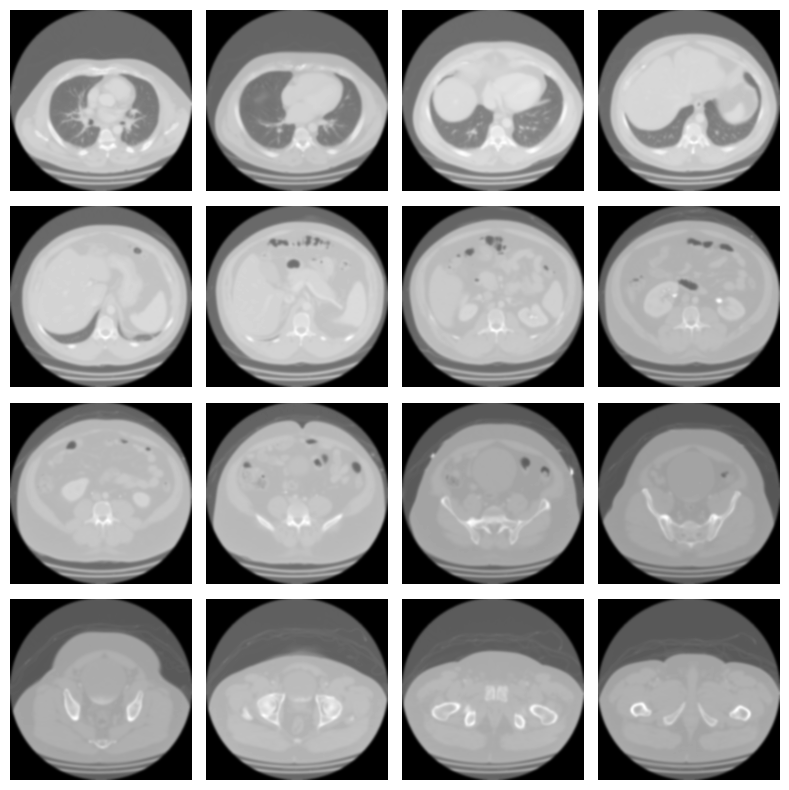

In [ ]:
# Below we increase sigma to 3, resulting in a more smoothed image:
sigma = 3
smoothed = ndi.gaussian_filter(id19_im_vol, sigma)

fig_rows = 4
fig_cols = 4
n_subplots = fig_rows * fig_cols
n_slice = id19_im_vol.shape[0]
step_size = n_slice // n_subplots
plot_range = n_subplots * step_size

start_stop = int((n_slice - plot_range) / 2)
fig, axs = plt.subplots(fig_rows, fig_cols, figsize=[8, 8])

for idx, img in enumerate(range(start_stop, plot_range, step_size)):
    axs.flat[idx].imshow(smoothed[img, :, :], cmap='gray')
    axs.flat[idx].axis('off')

plt.tight_layout()
plt.show()


## _Segmenting smoothed images_

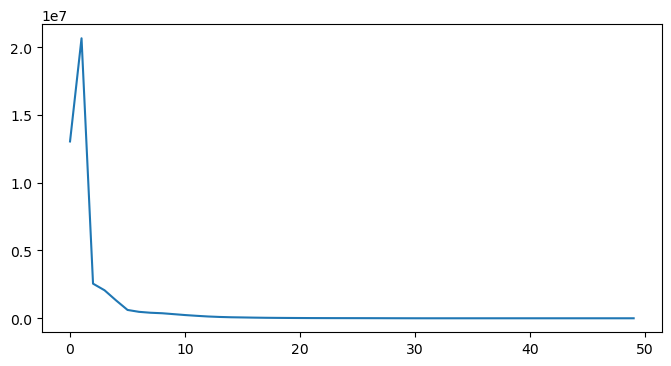

In [ ]:
plt.figure(figsize=(8, 4))

filt = ndi.gaussian_filter(id19_im_vol, sigma=2)
plt.plot(ndi.histogram(filt, min=0, max=np.max(filt), bins=50))
plt.show()

## _Let us animate our image along the axial plane_

In [ ]:
# The shape of the stacked images in each plane (Axial, Coronal, and Sagittal, respectively)
n0, n1, n2 = id19_im_vol.meta.shape

# define sampling resolution along each axis
d0, d1, d2 = id19_im_vol.meta.sampling

# calculate axial aspect ratio
axial_asp = d1 / d2

# calculate sagittal aspect ratio
sagittal_asp = d0 / d1

# calculate coronal aspect ratio
coronal_asp = d0 / d2

# calculate field of view along each axis
axial = n0 * d0
coronal = n1 * d1
sagittal = n2 * d2

# Add a slider that starts with 0 and ends at the number of slices along the axial plane, n0=673.
@widgets.interact(axial_slice=(1, n0-1))

# Define the function that shows the images of the specified slice number.
# It starts with the 1th slice. And you can scroll over any slice

# using the slider.
def axial_slicer(axial_slice=60):
  fig, ax = plt.subplots(1, 1, figsize=(4, 4))

  # Show the image of the specified slice number in 'gray' color-map
  # and axial aspect ratio
  ax.imshow(id19_im_vol[axial_slice,:,:], cmap='bone', aspect=axial_asp)

  # Don't show the axis
  ax.axis('off')

interactive(children=(IntSlider(value=60, description='axial_slice', max=672, min=1), Output()), _dom_classes=…

In [ ]:
# The shape of the stacked images in each plane
# (Axial, Coronal, and Sagittal, respectively)
n0, n1, n2 = id19_im_vol.shape

# Print the ouput
print('\n'"Number of Slices:\n\t", "Axial=", n0, "Slices\n\t","Coronal=", n1, "Slices\n\t","Sagittal=", n2, "Slices")


Number of Slices:
	 Axial= 673 Slices
	 Coronal= 512 Slices
	 Sagittal= 512 Slices


In [ ]:
# Print the output (Axial, Coronal, and Sagittal, respectively)
print('\n'"Sampling:\n\t", "Axial=", d0, "mm\n\t","Coronal=", d1, "mm\n\t","Sagittal=", d2, "mm")


Sampling:
	 Axial= 0.7999999999999998 mm
	 Coronal= 0.904 mm
	 Sagittal= 0.904 mm


In [ ]:
# Print the aspect ratio (Axial, Coronal, and Sagittal, respectively)
print('\n'"Pixel Aspect Ratio:\n\t", "Axial=", axial_asp, "\n\t","Coronal=", coronal_asp, "\n\t","Sagittal=", sagittal_asp)


Pixel Aspect Ratio:
	 Axial= 1.0 
	 Coronal= 0.8849557522123892 
	 Sagittal= 0.8849557522123892


In [ ]:
# Field of View
print('\n'"Field of View:\n\t", "Axial=", n0*d0, "mm\n\t","Coronal=", n1*d1, "mm\n\t","Sagittal=", n2*d2, "mm")


Field of View:
	 Axial= 538.3999999999999 mm
	 Coronal= 462.848 mm
	 Sagittal= 462.848 mm


----------------

**_LET'S INTERACTIVELY VISUALIZE & ANIMATE THE PATIENT ID #19 ALONG THE 3 PLANES_**

In [ ]:
# Add three sliders that start with 0 and ends at the number of slices along each plane.
# Axial:    n0=673  slice
# Corornal: n1=512  slice
# Sagittal: n2=512  slice

@widgets.interact(axial_slice=(0,n0-1), coronal_slice=(0,n1-1),sagittal_slice=(0,n2-1))

def slicer(axial_slice, coronal_slice, sagittal_slice=100):
  fig, ax = plt.subplots(1, 3, figsize=(12, 12))

  # Show the specfied slice on the axial plane with 'gray' color-map
  # and axial aspect ratio.
  ax[0].imshow(id19_im_vol[axial_slice,:,:], cmap='bone', aspect= axial_asp)
  ax[0].axis('off')
  ax[0].set_title('Axial')

  # Show the specified slice on the coronal plane with 'gray' color-map
  # and coronal aspect ratio.
  ax[1].imshow(id19_im_vol[:,coronal_slice,:], cmap='bone', aspect= coronal_asp)
  ax[1].axis('off')
  ax[1].set_title('Coronal')

  # Show the specified slice on the sagittal plane with 'gray' color-map
  # and sagittal aspect ratio.
  ax[2].imshow(id19_im_vol[:,:,sagittal_slice], cmap='bone', aspect= sagittal_asp)
  ax[2].axis('off')
  ax[2].set_title('Sagittal')

interactive(children=(IntSlider(value=336, description='axial_slice', max=672), IntSlider(value=255, descripti…

----------------

**_In sum, it's worth noting that to visualize the extracted CT Scan images or region of interest, 3D images represent the entire CT Scan for the patient and will lead to accurate analysis or interpretation_**

**_Based on the result above, it is allowed to conclude to the main difference between visualizing only few 2D CT scan images instead out of all or 3D medical images in nibabel or dicom format is the amount of information that can be observed and compared.When visualizing a subset of the images, you may miss out on important patterns or variations that could be present in the full 3D CT scan image or a dataset_**.

**_it is important to consult with a medical professional or domain expert when working with medical images, as they can provide valuable insights and guidance on how to interpret and analyze the data. I will be more than happy to work with one of them_**

## END OF BIOMEDICAL IMAGE ANALYSIS IN PYTHON

-----------------

## PART II - DEEP LEARNING OPS (RNSA ABDOMINAL TRAUMA DETECTION)

## 1. _Data preparation_

In [ ]:
# display
train_dicom_tags.head()

,BitsAllocated,BitsStored,Columns,ContentDate,ContentTime,FrameOfReferenceUID,HighBit,ImageOrientationPatient,ImagePositionPatient,InstanceNumber,...,WindowCenter,WindowWidth,FileMetaInformationVersion,ImplementationClassUID,ImplementationVersionName,MediaStorageSOPClassUID,MediaStorageSOPInstanceUID,TransferSyntaxUID,path,RescaleType
0,16,16,512,20230722,003306.881589,1.2.826.0.1.3680043.8.498.28466454913303094199...,15,"[1.00000, 0.00000, 0.00000, 0.00000, 1.00000, ...","[-235.8665, -235.8665, 1459.20]",532,...,50.0,400.0, ,1.2.3.123456.4.5.1234.1.12.0,PYDICOM 2.4.0,1.2.840.10008.5.1.4.1.1.2,1.2.123.12345.1.2.3.49954.1.532,1.2.840.10008.1.2.5,train_images/49954/41479/532.dcm,nan
1,16,16,512,20230722,003303.279137,1.2.826.0.1.3680043.8.498.28466454913303094199...,15,"[1.00000, 0.00000, 0.00000, 0.00000, 1.00000, ...","[-235.8665, -235.8665, 1474.40]",513,...,50.0,400.0, ,1.2.3.123456.4.5.1234.1.12.0,PYDICOM 2.4.0,1.2.840.10008.5.1.4.1.1.2,1.2.123.12345.1.2.3.49954.1.513,1.2.840.10008.1.2.5,train_images/49954/41479/513.dcm,nan
2,16,16,512,20230722,003343.090736,1.2.826.0.1.3680043.8.498.28466454913303094199...,15,"[1.00000, 0.00000, 0.00000, 0.00000, 1.00000, ...","[-235.8665, -235.8665, 1310.40]",718,...,50.0,400.0, ,1.2.3.123456.4.5.1234.1.12.0,PYDICOM 2.4.0,1.2.840.10008.5.1.4.1.1.2,1.2.123.12345.1.2.3.49954.1.718,1.2.840.10008.1.2.5,train_images/49954/41479/718.dcm,nan
3,16,16,512,20230722,003252.960345,1.2.826.0.1.3680043.8.498.28466454913303094199...,15,"[1.00000, 0.00000, 0.00000, 0.00000, 1.00000, ...","[-235.8665, -235.8665, 1520.00]",456,...,50.0,400.0, ,1.2.3.123456.4.5.1234.1.12.0,PYDICOM 2.4.0,1.2.840.10008.5.1.4.1.1.2,1.2.123.12345.1.2.3.49954.1.456,1.2.840.10008.1.2.5,train_images/49954/41479/456.dcm,nan
4,16,16,512,20230722,003155.059398,1.2.826.0.1.3680043.8.498.28466454913303094199...,15,"[1.00000, 0.00000, 0.00000, 0.00000, 1.00000, ...","[-235.8665, -235.8665, 1756.00]",161,...,50.0,400.0, ,1.2.3.123456.4.5.1234.1.12.0,PYDICOM 2.4.0,1.2.840.10008.5.1.4.1.1.2,1.2.123.12345.1.2.3.49954.1.161,1.2.840.10008.1.2.5,train_images/49954/41479/161.dcm,nan


In [ ]:
# Lower all columns in train_dicom_tags
train_dicom_tags.columns = [col.lower() for col in train_dicom_tags.columns]

# renane the column patientid to patient_id
train_dicom_tags.rename(columns={'patientid': 'patient_id'}, inplace=True)

# Set the maximun column to display a 50
pd.set_option('display.max_columns', 50)

In [ ]:
# display 3 random sample from the dataframe
train_dicom_tags.sample(3)

,bitsallocated,bitsstored,columns,contentdate,contenttime,frameofreferenceuid,highbit,imageorientationpatient,imagepositionpatient,instancenumber,kvp,patient_id,patientposition,photometricinterpretation,pixelrepresentation,pixelspacing,rescaleintercept,rescaleslope,rows,sopinstanceuid,samplesperpixel,seriesinstanceuid,seriesnumber,slicethickness,studyinstanceuid,windowcenter,windowwidth,filemetainformationversion,implementationclassuid,implementationversionname,mediastoragesopclassuid,mediastoragesopinstanceuid,transfersyntaxuid,path,rescaletype
1348576,16,12,512,20230722,004026.004611,1.2.826.0.1.3680043.8.498.49420134606984463069...,11,"[1.0, 0.0, 0.0, 0.0, 1.0, 0.0]","[-215.64453, -324.64453, -95.1]",375,100.0,52827,FFS,MONOCHROME2,0,"[0.7109375, 0.7109375]",-1024.0,1.0,512,1.2.123.12345.1.2.3.52827.1.375,1,1.2.123.12345.1.2.3.52827.42787,15,1.0,1.2.123.12345.1.2.3.52827,50.0,400.0, ,1.2.3.123456.4.5.1234.1.12.0,PYDICOM 2.4.0,1.2.840.10008.5.1.4.1.1.2,1.2.123.12345.1.2.3.52827.1.375,1.2.840.10008.1.2.5,train_images/52827/42787/375.dcm,HU
934963,16,16,512,20230721,233303.483438,1.2.826.0.1.3680043.8.498.12679140529535254239...,15,"[1.00000, 0.00000, 0.00000, 0.00000, 1.00000, ...","[-170.5474, -179.3365, 1491.50]",491,120.0,7944,FFS,MONOCHROME2,1,"[0.702, 0.702]",0.0,1.0,512,1.2.123.12345.1.2.3.7944.1.491,1,1.2.123.12345.1.2.3.7944.35443,6,1.0,1.2.123.12345.1.2.3.7944,50.0,400.0, ,1.2.3.123456.4.5.1234.1.12.0,PYDICOM 2.4.0,1.2.840.10008.5.1.4.1.1.2,1.2.123.12345.1.2.3.7944.1.491,1.2.840.10008.1.2.5,train_images/7944/35443/491.dcm,nan
1495428,16,16,512,20230722,003522.663403,1.2.826.0.1.3680043.8.498.74707817635842093354...,15,"[0.999982, 0.000000, -0.005987, 0.000000, 1.00...","[-238.372, -241.916, -758.398]",230,120.0,60744,FFS,MONOCHROME2,1,"[0.911427, 0.911427]",-1024.0,1.0,512,1.2.123.12345.1.2.3.60744.1.230,1,1.2.123.12345.1.2.3.60744.10494,605,2.5,1.2.123.12345.1.2.3.60744,50.0,400.0, ,1.2.3.123456.4.5.1234.1.12.0,PYDICOM 2.4.0,1.2.840.10008.5.1.4.1.1.2,1.2.123.12345.1.2.3.60744.1.230,1.2.840.10008.1.2.5,train_images/60744/10494/230.dcm,Houndsfield Unit


In [ ]:
# Convert patient_id data type object to int
train_dicom_tags['patient_id'] = train_dicom_tags['patient_id'].astype(str).astype(int)

# Double check the change
train_dicom_tags.shape

(1510373, 35)

In [ ]:
# Merge tarin_dicom_tags and train labels on patient_id
train_merged_df = pd.merge(train_dicom_tags, train_labels, on = 'patient_id', how = 'inner')

In [ ]:
# View train merged df
train_merged_df.head()

,bitsallocated,bitsstored,columns,contentdate,contenttime,frameofreferenceuid,highbit,imageorientationpatient,imagepositionpatient,instancenumber,kvp,patient_id,patientposition,photometricinterpretation,pixelrepresentation,pixelspacing,rescaleintercept,rescaleslope,rows,sopinstanceuid,samplesperpixel,seriesinstanceuid,seriesnumber,slicethickness,studyinstanceuid,windowcenter,windowwidth,filemetainformationversion,implementationclassuid,implementationversionname,mediastoragesopclassuid,mediastoragesopinstanceuid,transfersyntaxuid,path,rescaletype,bowel_healthy,bowel_injury,extravasation_healthy,extravasation_injury,kidney_healthy,kidney_low,kidney_high,liver_healthy,liver_low,liver_high,spleen_healthy,spleen_low,spleen_high,any_injury
0,16,16,512,20230722,003306.881589,1.2.826.0.1.3680043.8.498.28466454913303094199...,15,"[1.00000, 0.00000, 0.00000, 0.00000, 1.00000, ...","[-235.8665, -235.8665, 1459.20]",532,120.0,49954,FFS,MONOCHROME2,1,"[0.923, 0.923]",0.0,1.0,512,1.2.123.12345.1.2.3.49954.1.532,1,1.2.123.12345.1.2.3.49954.41479,6,1.0,1.2.123.12345.1.2.3.49954,50.0,400.0, ,1.2.3.123456.4.5.1234.1.12.0,PYDICOM 2.4.0,1.2.840.10008.5.1.4.1.1.2,1.2.123.12345.1.2.3.49954.1.532,1.2.840.10008.1.2.5,train_images/49954/41479/532.dcm,nan,1,0,1,0,1,0,0,1,0,0,1,0,0,0
1,16,16,512,20230722,003303.279137,1.2.826.0.1.3680043.8.498.28466454913303094199...,15,"[1.00000, 0.00000, 0.00000, 0.00000, 1.00000, ...","[-235.8665, -235.8665, 1474.40]",513,120.0,49954,FFS,MONOCHROME2,1,"[0.923, 0.923]",0.0,1.0,512,1.2.123.12345.1.2.3.49954.1.513,1,1.2.123.12345.1.2.3.49954.41479,6,1.0,1.2.123.12345.1.2.3.49954,50.0,400.0, ,1.2.3.123456.4.5.1234.1.12.0,PYDICOM 2.4.0,1.2.840.10008.5.1.4.1.1.2,1.2.123.12345.1.2.3.49954.1.513,1.2.840.10008.1.2.5,train_images/49954/41479/513.dcm,nan,1,0,1,0,1,0,0,1,0,0,1,0,0,0
2,16,16,512,20230722,003343.090736,1.2.826.0.1.3680043.8.498.28466454913303094199...,15,"[1.00000, 0.00000, 0.00000, 0.00000, 1.00000, ...","[-235.8665, -235.8665, 1310.40]",718,120.0,49954,FFS,MONOCHROME2,1,"[0.923, 0.923]",0.0,1.0,512,1.2.123.12345.1.2.3.49954.1.718,1,1.2.123.12345.1.2.3.49954.41479,6,1.0,1.2.123.12345.1.2.3.49954,50.0,400.0, ,1.2.3.123456.4.5.1234.1.12.0,PYDICOM 2.4.0,1.2.840.10008.5.1.4.1.1.2,1.2.123.12345.1.2.3.49954.1.718,1.2.840.10008.1.2.5,train_images/49954/41479/718.dcm,nan,1,0,1,0,1,0,0,1,0,0,1,0,0,0
3,16,16,512,20230722,003252.960345,1.2.826.0.1.3680043.8.498.28466454913303094199...,15,"[1.00000, 0.00000, 0.00000, 0.00000, 1.00000, ...","[-235.8665, -235.8665, 1520.00]",456,120.0,49954,FFS,MONOCHROME2,1,"[0.923, 0.923]",0.0,1.0,512,1.2.123.12345.1.2.3.49954.1.456,1,1.2.123.12345.1.2.3.49954.41479,6,1.0,1.2.123.12345.1.2.3.49954,50.0,400.0, ,1.2.3.123456.4.5.1234.1.12.0,PYDICOM 2.4.0,1.2.840.10008.5.1.4.1.1.2,1.2.123.12345.1.2.3.49954.1.456,1.2.840.10008.1.2.5,train_images/49954/41479/456.dcm,nan,1,0,1,0,1,0,0,1,0,0,1,0,0,0
4,16,16,512,20230722,003155.059398,1.2.826.0.1.3680043.8.498.28466454913303094199...,15,"[1.00000, 0.00000, 0.00000, 0.00000, 1.00000, ...","[-235.8665, -235.8665, 1756.00]",161,120.0,49954,FFS,MONOCHROME2,1,"[0.923, 0.923]",0.0,1.0,512,1.2.123.12345.1.2.3.49954.1.161,1,1.2.123.12345.1.2.3.49954.41479,6,1.0,1.2.123.12345.1.2.3.49954,50.0,400.0, ,1.2.3.123456.4.5.1234.1.12.0,PYDICOM 2.4.0,1.2.840.10008.5.1.4.1.1.2,1.2.123.12345.1.2.3.49954.1.161,1.2.840.10008.1.2.5,train_images/49954/41479/161.dcm,nan,1,0,1,0,1,0,0,1,0,0,1,0,0,0


In [ ]:
# sort merge train df by patient_id
sorted_tr_merged_df = train_merged_df.sort_values(by=['patient_id'], ascending=True)

# Double check the shape
print('We have a total of', sorted_tr_merged_df.shape[0], 'rows and', sorted_tr_merged_df.shape[1], 'columns')

We have a total of 1510373 rows and 49 columns


In [ ]:
sorted_tr_merged_df.head()

,bitsallocated,bitsstored,columns,contentdate,contenttime,frameofreferenceuid,highbit,imageorientationpatient,imagepositionpatient,instancenumber,kvp,patient_id,patientposition,photometricinterpretation,pixelrepresentation,pixelspacing,rescaleintercept,rescaleslope,rows,sopinstanceuid,samplesperpixel,seriesinstanceuid,seriesnumber,slicethickness,studyinstanceuid,windowcenter,windowwidth,filemetainformationversion,implementationclassuid,implementationversionname,mediastoragesopclassuid,mediastoragesopinstanceuid,transfersyntaxuid,path,rescaletype,bowel_healthy,bowel_injury,extravasation_healthy,extravasation_injury,kidney_healthy,kidney_low,kidney_high,liver_healthy,liver_low,liver_high,spleen_healthy,spleen_low,spleen_high,any_injury
1477607,16,16,512,20230721,231332.989136,1.2.826.0.1.3680043.8.498.78212013234887074308...,15,"[1.00000, 0.00000, 0.00000, 0.00000, 1.00000, ...","[-228.0635, -221.2276, 1322.00]",711,120.0,19,FFS,MONOCHROME2,1,"[0.904, 0.904]",0.0,1.0,512,1.2.123.12345.1.2.3.19.1.711,1,1.2.123.12345.1.2.3.19.14374,7,1.0,1.2.123.12345.1.2.3.19,50.0,400.0, ,1.2.3.123456.4.5.1234.1.12.0,PYDICOM 2.4.0,1.2.840.10008.5.1.4.1.1.2,1.2.123.12345.1.2.3.19.1.711,1.2.840.10008.1.2.5,train_images/19/14374/711.dcm,nan,1,0,1,0,1,0,0,1,0,0,1,0,0,0
1478053,16,16,512,20230721,231259.395330,1.2.826.0.1.3680043.8.498.78212013234887074308...,15,"[1.00000, 0.00000, 0.00000, 0.00000, 1.00000, ...","[-228.0635, -221.2276, 1497.20]",492,120.0,19,FFS,MONOCHROME2,1,"[0.904, 0.904]",0.0,1.0,512,1.2.123.12345.1.2.3.19.1.492,1,1.2.123.12345.1.2.3.19.14374,7,1.0,1.2.123.12345.1.2.3.19,50.0,400.0, ,1.2.3.123456.4.5.1234.1.12.0,PYDICOM 2.4.0,1.2.840.10008.5.1.4.1.1.2,1.2.123.12345.1.2.3.19.1.492,1.2.840.10008.1.2.5,train_images/19/14374/492.dcm,nan,1,0,1,0,1,0,0,1,0,0,1,0,0,0
1478054,16,16,512,20230721,231316.914615,1.2.826.0.1.3680043.8.498.78212013234887074308...,15,"[1.00000, 0.00000, 0.00000, 0.00000, 1.00000, ...","[-228.0635, -221.2276, 1404.40]",608,120.0,19,FFS,MONOCHROME2,1,"[0.904, 0.904]",0.0,1.0,512,1.2.123.12345.1.2.3.19.1.608,1,1.2.123.12345.1.2.3.19.14374,7,1.0,1.2.123.12345.1.2.3.19,50.0,400.0, ,1.2.3.123456.4.5.1234.1.12.0,PYDICOM 2.4.0,1.2.840.10008.5.1.4.1.1.2,1.2.123.12345.1.2.3.19.1.608,1.2.840.10008.1.2.5,train_images/19/14374/608.dcm,nan,1,0,1,0,1,0,0,1,0,0,1,0,0,0
1478055,16,16,512,20230721,231346.780187,1.2.826.0.1.3680043.8.498.78212013234887074308...,15,"[1.00000, 0.00000, 0.00000, 0.00000, 1.00000, ...","[-228.0635, -221.2276, 1251.60]",799,120.0,19,FFS,MONOCHROME2,1,"[0.904, 0.904]",0.0,1.0,512,1.2.123.12345.1.2.3.19.1.799,1,1.2.123.12345.1.2.3.19.14374,7,1.0,1.2.123.12345.1.2.3.19,50.0,400.0, ,1.2.3.123456.4.5.1234.1.12.0,PYDICOM 2.4.0,1.2.840.10008.5.1.4.1.1.2,1.2.123.12345.1.2.3.19.1.799,1.2.840.10008.1.2.5,train_images/19/14374/799.dcm,nan,1,0,1,0,1,0,0,1,0,0,1,0,0,0
1478056,16,16,512,20230721,231233.851893,1.2.826.0.1.3680043.8.498.78212013234887074308...,15,"[1.00000, 0.00000, 0.00000, 0.00000, 1.00000, ...","[-228.0635, -221.2276, 1625.20]",332,120.0,19,FFS,MONOCHROME2,1,"[0.904, 0.904]",0.0,1.0,512,1.2.123.12345.1.2.3.19.1.332,1,1.2.123.12345.1.2.3.19.14374,7,1.0,1.2.123.12345.1.2.3.19,50.0,400.0, ,1.2.3.123456.4.5.1234.1.12.0,PYDICOM 2.4.0,1.2.840.10008.5.1.4.1.1.2,1.2.123.12345.1.2.3.19.1.332,1.2.840.10008.1.2.5,train_images/19/14374/332.dcm,nan,1,0,1,0,1,0,0,1,0,0,1,0,0,0


In [ ]:
sorted_tr_merged_df.set_index('patient_id')[:5]

,bitsallocated,bitsstored,columns,contentdate,contenttime,frameofreferenceuid,highbit,imageorientationpatient,imagepositionpatient,instancenumber,kvp,patientposition,photometricinterpretation,pixelrepresentation,pixelspacing,rescaleintercept,rescaleslope,rows,sopinstanceuid,samplesperpixel,seriesinstanceuid,seriesnumber,slicethickness,studyinstanceuid,windowcenter,windowwidth,filemetainformationversion,implementationclassuid,implementationversionname,mediastoragesopclassuid,mediastoragesopinstanceuid,transfersyntaxuid,path,rescaletype,bowel_healthy,bowel_injury,extravasation_healthy,extravasation_injury,kidney_healthy,kidney_low,kidney_high,liver_healthy,liver_low,liver_high,spleen_healthy,spleen_low,spleen_high,any_injury
patient_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
19,16,16,512,20230721,231332.989136,1.2.826.0.1.3680043.8.498.78212013234887074308...,15,"[1.00000, 0.00000, 0.00000, 0.00000, 1.00000, ...","[-228.0635, -221.2276, 1322.00]",711,120.0,FFS,MONOCHROME2,1,"[0.904, 0.904]",0.0,1.0,512,1.2.123.12345.1.2.3.19.1.711,1,1.2.123.12345.1.2.3.19.14374,7,1.0,1.2.123.12345.1.2.3.19,50.0,400.0, ,1.2.3.123456.4.5.1234.1.12.0,PYDICOM 2.4.0,1.2.840.10008.5.1.4.1.1.2,1.2.123.12345.1.2.3.19.1.711,1.2.840.10008.1.2.5,train_images/19/14374/711.dcm,nan,1,0,1,0,1,0,0,1,0,0,1,0,0,0
19,16,16,512,20230721,231259.395330,1.2.826.0.1.3680043.8.498.78212013234887074308...,15,"[1.00000, 0.00000, 0.00000, 0.00000, 1.00000, ...","[-228.0635, -221.2276, 1497.20]",492,120.0,FFS,MONOCHROME2,1,"[0.904, 0.904]",0.0,1.0,512,1.2.123.12345.1.2.3.19.1.492,1,1.2.123.12345.1.2.3.19.14374,7,1.0,1.2.123.12345.1.2.3.19,50.0,400.0, ,1.2.3.123456.4.5.1234.1.12.0,PYDICOM 2.4.0,1.2.840.10008.5.1.4.1.1.2,1.2.123.12345.1.2.3.19.1.492,1.2.840.10008.1.2.5,train_images/19/14374/492.dcm,nan,1,0,1,0,1,0,0,1,0,0,1,0,0,0
19,16,16,512,20230721,231316.914615,1.2.826.0.1.3680043.8.498.78212013234887074308...,15,"[1.00000, 0.00000, 0.00000, 0.00000, 1.00000, ...","[-228.0635, -221.2276, 1404.40]",608,120.0,FFS,MONOCHROME2,1,"[0.904, 0.904]",0.0,1.0,512,1.2.123.12345.1.2.3.19.1.608,1,1.2.123.12345.1.2.3.19.14374,7,1.0,1.2.123.12345.1.2.3.19,50.0,400.0, ,1.2.3.123456.4.5.1234.1.12.0,PYDICOM 2.4.0,1.2.840.10008.5.1.4.1.1.2,1.2.123.12345.1.2.3.19.1.608,1.2.840.10008.1.2.5,train_images/19/14374/608.dcm,nan,1,0,1,0,1,0,0,1,0,0,1,0,0,0
19,16,16,512,20230721,231346.780187,1.2.826.0.1.3680043.8.498.78212013234887074308...,15,"[1.00000, 0.00000, 0.00000, 0.00000, 1.00000, ...","[-228.0635, -221.2276, 1251.60]",799,120.0,FFS,MONOCHROME2,1,"[0.904, 0.904]",0.0,1.0,512,1.2.123.12345.1.2.3.19.1.799,1,1.2.123.12345.1.2.3.19.14374,7,1.0,1.2.123.12345.1.2.3.19,50.0,400.0, ,1.2.3.123456.4.5.1234.1.12.0,PYDICOM 2.4.0,1.2.840.10008.5.1.4.1.1.2,1.2.123.12345.1.2.3.19.1.799,1.2.840.10008.1.2.5,train_images/19/14374/799.dcm,nan,1,0,1,0,1,0,0,1,0,0,1,0,0,0
19,16,16,512,20230721,231233.851893,1.2.826.0.1.3680043.8.498.78212013234887074308...,15,"[1.00000, 0.00000, 0.00000, 0.00000, 1.00000, ...","[-228.0635, -221.2276, 1625.20]",332,120.0,FFS,MONOCHROME2,1,"[0.904, 0.904]",0.0,1.0,512,1.2.123.12345.1.2.3.19.1.332,1,1.2.123.12345.1.2.3.19.14374,7,1.0,1.2.123.12345.1.2.3.19,50.0,400.0, ,1.2.3.123456.4.5.1234.1.12.0,PYDICOM 2.4.0,1.2.840.10008.5.1.4.1.1.2,1.2.123.12345.1.2.3.19.1.332,1.2.840.10008.1.2.5,train_images/19/14374/332.dcm,nan,1,0,1,0,1,0,0,1,0,0,1,0,0,0


In [ ]:
sorted_tr_merged_df.shape

(1510373, 49)

In [ ]:
# Split the original DataFrame into a training set and a temporary set
train_df, temp_df = train_test_split(sorted_tr_merged_df, test_size=0.3, random_state=42)

# Split the temporary set into a validation set and a test set
val_df, test_df = train_test_split(temp_df, test_size=0.5, random_state=42)

# Print the shapes of the resulting DataFrames
print(f"Train set shape: {train_df.shape}")
print(f"Validation set shape: {val_df.shape}")
print(f"Test set shape: {test_df.shape}")

Train set shape: (1057261, 49)
Validation set shape: (226556, 49)
Test set shape: (226556, 49)


Define the directory containing the patient_id, series_id
_train_paths = glob(f'{dsroot}/train_images/*/*/')_

_Create a Pandas Dataframe & set image path as a column_
train_images_df = pd.DataFrame(train_paths, columns=["image_path"])

Create & add a column patient_id to the existing dataframe
_train_images_df['patient_id'] = train_images_df.image_path.map(lambda x: x.split('/')[-3]).astype(int)_

Create & add a column series_id to the existing dataframe
_train_images_df['series_id'] = train_images_df.image_path.map(lambda x: x.split('/')[-2]).astype(int)_

Display the number of observations (row)
_print('\n'f'Number of rows in train_images: {train_images_df.shape[0]}')_